# Mix channels


## Results: 
    
Channels: panchro [0], 8 MS [1:9], 8 SWIR [9:17]
    
###   Vegetations

    - panchromatic[0] / MS[5] = Trees, Crops, Misc manmade structures (of trees) 
    - panchromatic[0] / MS[4] = Trees, Crops, Misc manmade structures (of trees) 
    - MS[1] / MS[5] = Trees, Crops, Misc manmade structures (of trees) 
    - MS[2] / MS[5] = Trees, Crops, Misc manmade structures (of trees) 
    - MS[6] / MS[4] = Trees, Crops, Misc manmade structures (of trees) 
    - MS[6] / MS[5] = Trees, Crops, Misc manmade structures (of trees) 
    - MS[7] / MS[4] = Trees, Crops, Misc manmade structures (of trees) 
    - MS[7] / MS[5] = Trees, Crops, Misc manmade structures (of trees) 
    - MS[7] / MS[10:17] = Trees, Crops, Misc manmade structures (of trees) 
    - MS[8] / MS[4] = Trees, Crops, Misc manmade structures (of trees) 
    - MS[8:17] / MS[5] = Trees, Crops, Misc manmade structures (of trees) 
        

### Buildings 

    - MS[2] / MS[9] = Less-vegetation, More buildings, structures etc
    - MS[4] / MS[9] = Less-vegetation, More buildings, structures etc

    - panchromatic[0] / MS[8] = Buildings, Manmade structures
    - panchromatic[0] / MS[7] = Buildings, Manmade structures
    
    - panchromatic[0] / MS[6] = Certain buildings, Manmade structures
    - MS[1] / MS[6:9] = Certain buildings, Manmade structures
    - MS[1] / MS[6:9] = Certain buildings, Manmade structures
    - MS[2] / MS[0] = Certain buildings, Manmade structures
    
    - MS[1] / MS[8] = Buildings, Manmade structures 
    - MS[1] / MS[7] = Buildings, Manmade structures 
    - MS[3] / MS[8] = Buildings, Manmade structures 
    - MS[3] / MS[7] = Buildings, Manmade structures 
    - MS[4] / MS[8] = Buildings, Manmade structures 
    - MS[4] / MS[7] = Buildings, Manmade structures 






In [17]:
# https://ipython.org/ipython-doc/3/config/extensions/autoreload.html
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [18]:
import numpy as np
import matplotlib.pylab as plt
from matplotlib.patches import Rectangle, Polygon, Patch
%matplotlib inline

In [19]:
import os 
import sys
sys.path.append("../common/")

In [20]:
from data_utils import GRID_SIZE, TRAIN_WKT, LABELS, get_resized_polygons, TRAIN_IMAGE_IDS, ALL_IMAGE_IDS
from image_utils import get_image_data, generate_pansharpened, generate_label_image, make_ratios_vegetation
from visu_utils import display_img_1b, display_img_3b, display_img_8b, display_labels

In [21]:
LABELS

['None',
 'Buildings',
 'Misc. Manmade structures',
 'Road',
 'Track',
 'Trees',
 'Crops',
 'Waterway',
 'Standing water',
 'Vehicle Large',
 'Vehicle Small']

### Analyse channel ratios

In [ ]:
# TRAIN_IMAGE_IDS

In [ ]:
# image_id = "6140_3_1"
# x = get_image_data(image_id, '17b')
# l = get_image_data(image_id, 'label')
# print x.shape, l.shape

In [ ]:
# ratios = make_ratios_vegetation(x)

In [ ]:
# n_channels = x.shape[2]
# n_labels = l.shape[2]
# n, m = 3, int(n_channels * 1.0 / 3.0 + 0.5), 
# plt.figure(figsize=(14,8))
# for i in range(n_channels):
#     plt.subplot(n, m, i+1)
#     display_img_1b(x[:,:,i])    
#     plt.title("Channel %i" % i)

# n, m = 3, int(n_labels * 1.0 / 3.0 + 0.5), 
# plt.figure(figsize=(14,8))
# for i in range(n_labels):
#     plt.subplot(n, m, i+1)
#     display_img_1b(l[:,:,i])    
#     plt.title("%s" % LABELS[i])

# n_channels = ratios.shape[2]    
# n, m = 3, int(n_channels * 1.0 / 3.0 + 0.5), 
# plt.figure(figsize=(14,8))
# for i in range(n_channels):
#     plt.subplot(n, m, i+1)
#     display_img_1b(ratios[:,:,i])    
#     plt.title("ratio %i" % i)

### Analyse whole non-tiled images

In [22]:
TRAIN_IMAGE_IDS

array(['6040_2_2', '6120_2_2', '6120_2_0', '6090_2_0', '6040_1_3',
       '6040_1_0', '6100_1_3', '6010_4_2', '6110_4_0', '6140_3_1',
       '6110_1_2', '6100_2_3', '6150_2_3', '6160_2_1', '6140_1_2',
       '6110_3_1', '6010_4_4', '6170_2_4', '6170_4_1', '6170_0_4',
       '6060_2_3', '6070_2_3', '6010_1_2', '6040_4_4', '6100_2_2'], dtype=object)

In [23]:
def display_ratio(num_index, denom_index, more_plots=False):
    num = x[:,:,num_index].astype(np.float)
    denom = x[:,:,denom_index].astype(np.float)
    ratio = num/(denom + 0.0001)

    roi = [1445, 1437, 1445+500, 1437+500]
    print ratio.shape, ratio.min(), ratio.max()

    fig_size = (14, 12)
    plt.figure(figsize=fig_size)
    plt.subplot(121)
    display_img_1b(ratio, roi)
    plt.title("Ratio : %i / %i" % (i,j))
    plt.subplot(122)
    display_img_1b(ratio, roi)
    plt.title("ratio + labels")
#     display_labels(label_img, roi, alpha=0.35, show_legend=False)
    
    if more_plots:
        plt.figure(figsize=fig_size)
        plt.subplot(131)
        display_img_1b(num, roi)
        plt.title("num")
        plt.subplot(132)
        display_img_1b(denom, roi)
        plt.title("denom")
        plt.subplot(133)
#         display_labels(label_img, roi)
        plt.title("labels")

### [NDVI](http://earthobservatory.nasa.gov/Features/MeasuringVegetation/measuring_vegetation_2.php) 

Nearly all satellite Vegetation Indices employ this difference formula to quantify the density of plant growth on the Earth — near-infrared radiation minus visible radiation divided by near-infrared radiation plus visible radiation. The result of this formula is called the Normalized Difference Vegetation Index (NDVI). Written mathematically, the formula is:
$$NDVI = (NIR — VIS)/(NIR + VIS)$$
Calculations of NDVI for a given pixel always result in a number that ranges from minus one (-1) to plus one (+1); however, no green leaves gives a value close to zero. A zero means no vegetation and close to +1 (0.8 - 0.9) indicates the highest possible density of green leaves.


Imagery details

Sensor : WorldView 3

Wavebands :

    - Panchromatic: 450-800 nm
    - 8 Multispectral: (red, red edge, coastal, blue, green, yellow, near-IR1 and near-IR2) 400 nm - 1040 nm
    - 8 SWIR: 1195 nm - 2365 nm


Sensor Resolution (GSD) at Nadir :

    Panchromatic: 0.31m 
    Multispectral: 1.24 m
    SWIR: Delivered at 7.5m

Dynamic Range
    
    - Panchromatic and multispectral : 11-bits per pixel
    - SWIR : 14-bits per pixel
    
```    
8 MS :   Coastal, Blue, Green, Yellow, Red, Red Edge, Near-IR1, Near-IR2
            1       2     3      4      5      6          7         8
```

In [24]:
image_id = "6040_2_2"
x = get_image_data(image_id, '17b')
label_img = generate_label_image(image_id)

In [39]:
def compute_ndvi_like(x, vis_index, nir_index):
    vis = x[:,:,vis_index].astype(np.float32)
    nir = x[:,:,nir_index].astype(np.float32())
    ndvi = (nir - vis) / (nir + vis + 0.00001)
    return ndvi

In [26]:
def display_ndvi_like(ndvi_like, label_img, roi, alpha, nir_ch, vis_ch):
    fig_size = (12, 12)
    plt.figure(figsize=fig_size)
    plt.subplot(121)
    display_img_1b(ndvi_like, roi)
    plt.title("ndvi-like: nir=%i, vis=%i" % (nir_ch, vis_ch))
    plt.subplot(122)
    display_img_1b(ndvi_like, roi)
    plt.title("ndvi-like + labels")
    display_labels(label_img, roi, alpha=alpha, show_legend=True)

In [ ]:
from ipywidgets import interact, IntSlider, FloatSlider

def interactive_ndvi_like(nir_ch, vis_ch, roi_x, roi_y, alpha):
    
    ndvi_like = compute_ndvi_like(x, vis_ch, nir_ch)
    roi = [roi_x, roi_y, roi_x+500, roi_y+500]
    display_ndvi_like(ndvi_like, label_img, roi, alpha, nir_ch, vis_ch)
    
_ = interact(interactive_ndvi_like,           
     nir_ch=IntSlider(value=8, min=1, max=16, continuous_update=False), 
     vis_ch=IntSlider(value=5, min=1, max=16, continuous_update=False), 
     roi_x=IntSlider(value=500, min=0, max=3500, continuous_update=False), 
     roi_y=IntSlider(value=1, min=0, max=3500, continuous_update=False), 
     alpha=FloatSlider(value=0.35, min=0, max=1.0, step=0.1, continuous_update=False))

Visualize ndvi-like channel ratios

In [ ]:
# def display_ratio(num_index, denom_index, more_plots=False):
#     num = x[:,:,num_index].astype(np.float)
#     denom = x[:,:,denom_index].astype(np.float)
#     ratio = num/(denom + 0.0001)

    
#     print ratio.shape, ratio.min(), ratio.max()

#     fig_size = (14, 12)
#     plt.figure(figsize=fig_size)
#     plt.subplot(121)
#     display_img_1b(ratio, roi)
#     plt.title("Ratio : %i / %i" % (i,j))
#     plt.subplot(122)
#     display_img_1b(ratio, roi)
#     plt.title("ratio + labels")

In [ ]:
roi = [1445, 1437, 1445+500, 1437+500]

In [ ]:
i = 1
for j in range(1,9):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

In [ ]:
i = 2
for j in range(1,9):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

In [ ]:
i = 3
for j in range(1,9):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

In [ ]:
i = 4
for j in range(1,9):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

In [ ]:
i = 5
for j in range(1,9):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

In [ ]:
i = 6
for j in range(1,9):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

In [ ]:
i = 7
for j in range(1,9):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

In [ ]:
i = 8
for j in range(1,9):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

NDVI-like ratios between SWIR channels on original size images

In [42]:
import cv2

In [52]:
img_swir = get_image_data(image_id, 'swir_aligned')
label_img_swir = generate_label_image(image_id, 'swir_aligned')
img_swir.shape, label_img_swir.shape

((134, 136, 8), (134, 136))

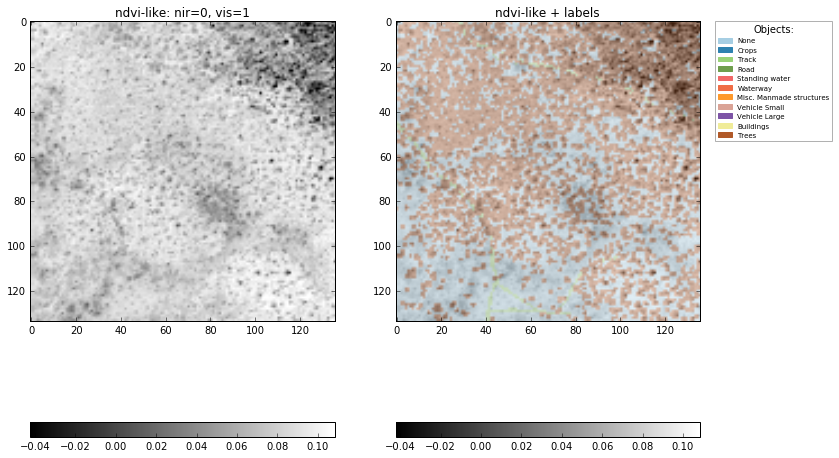

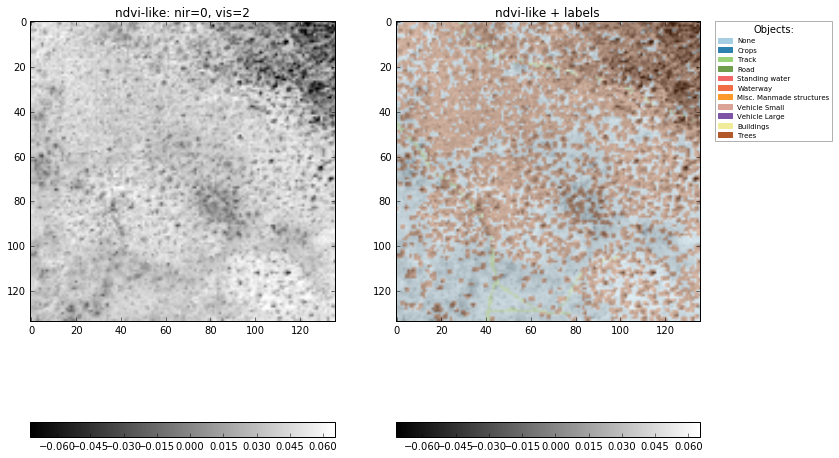

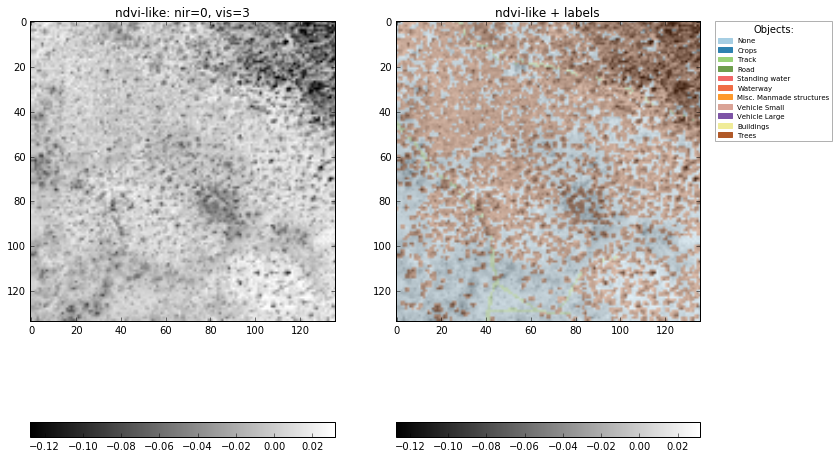

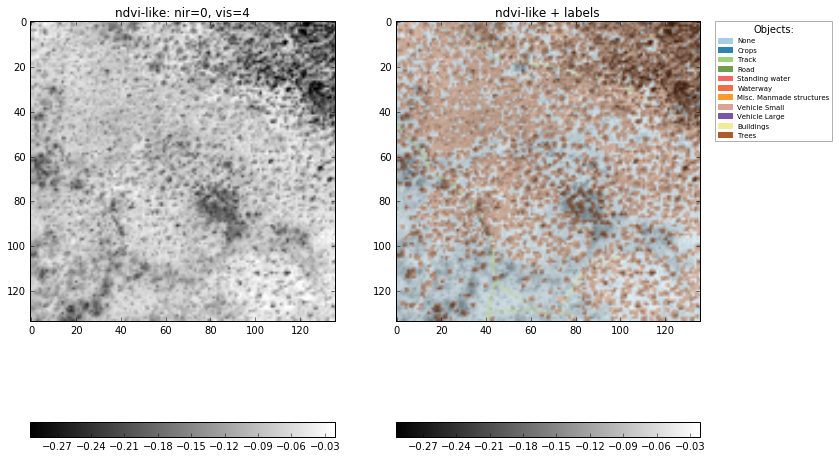

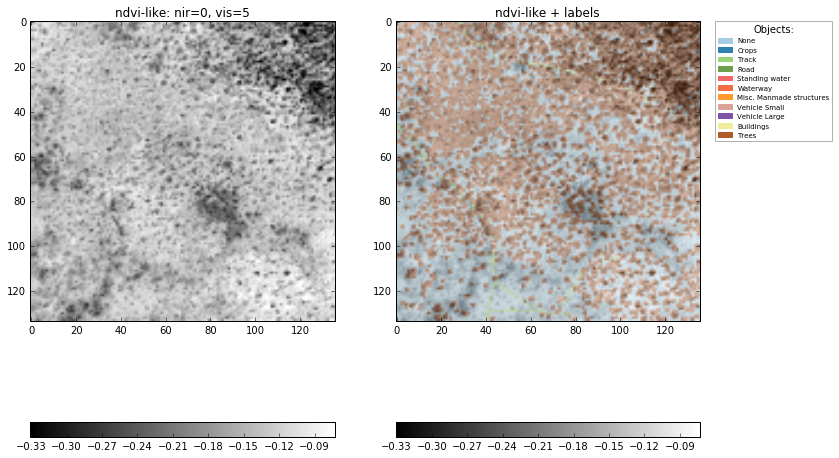

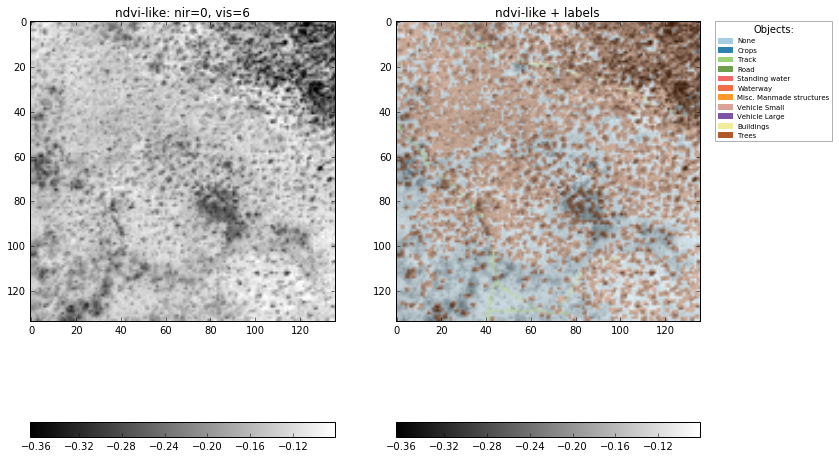

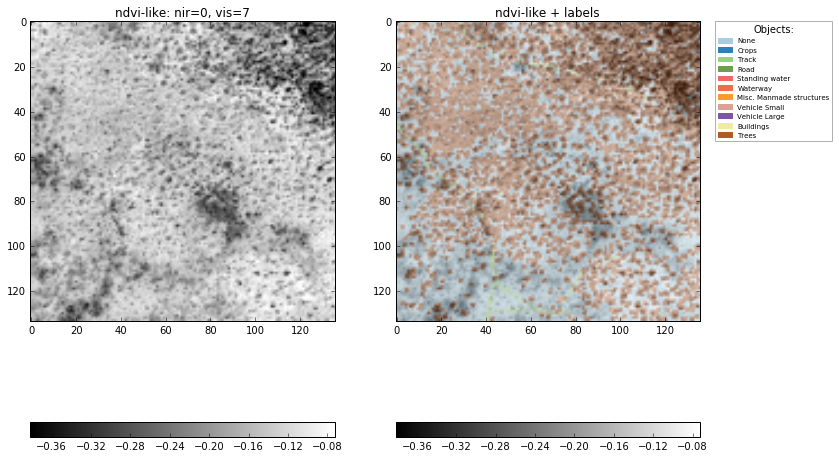

In [56]:
i = 0
for j in range(8):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(img_swir, i, j)
    display_ndvi_like(ndvi_like, label_img_swir, None, 0.35, i, j)    

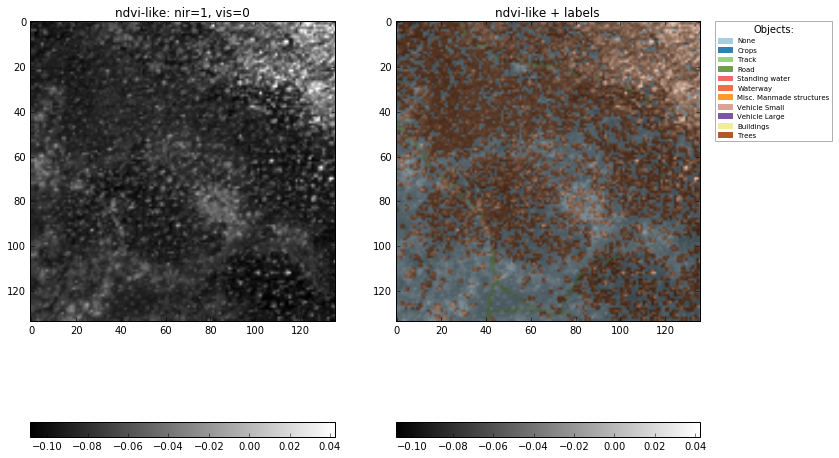

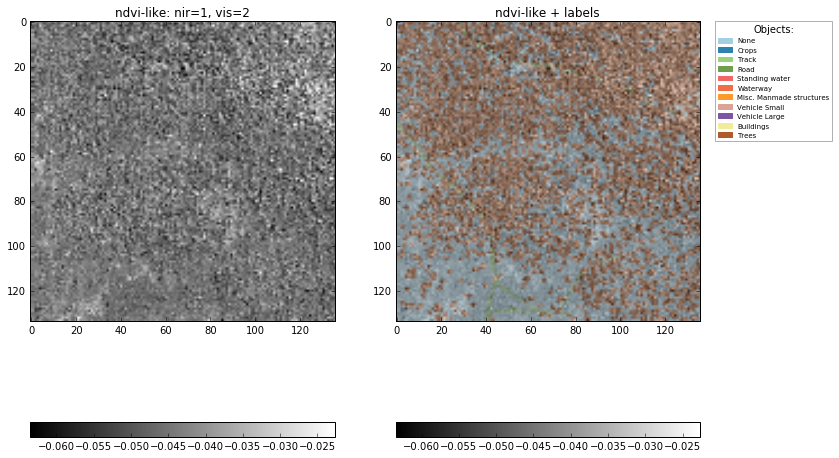

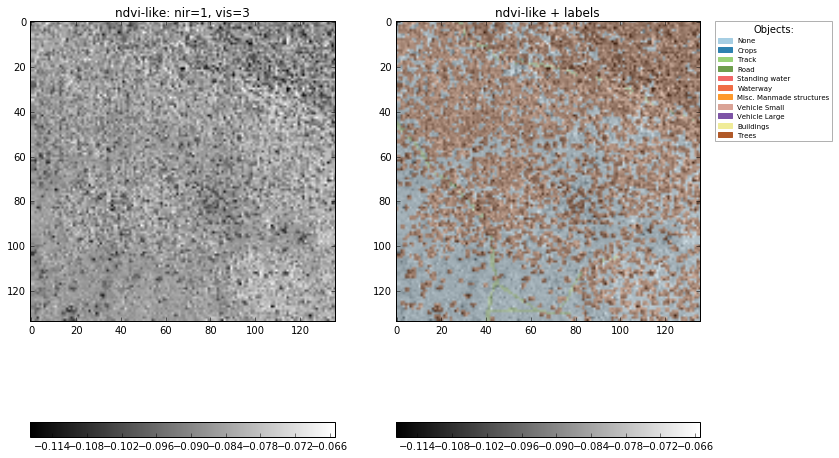

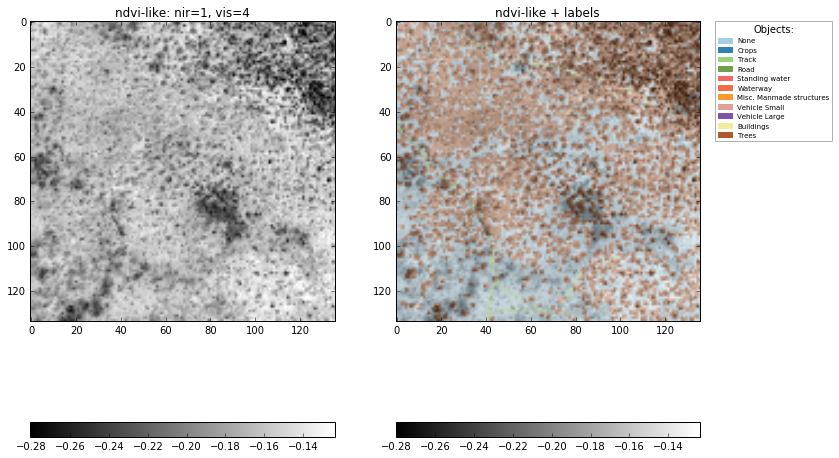

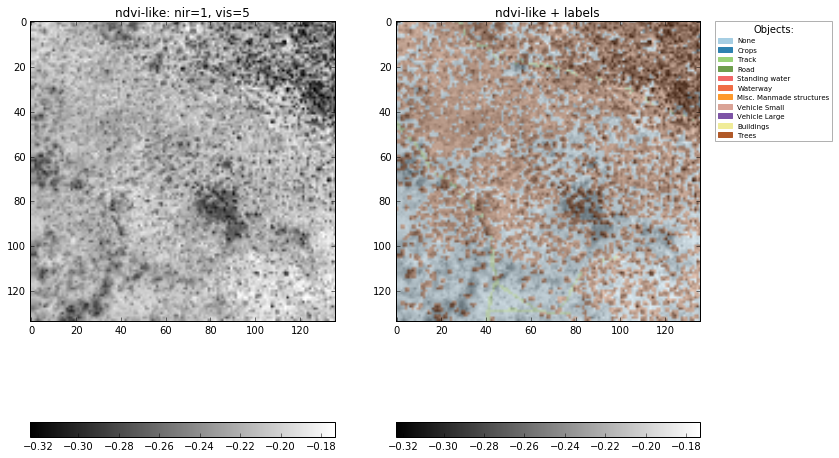

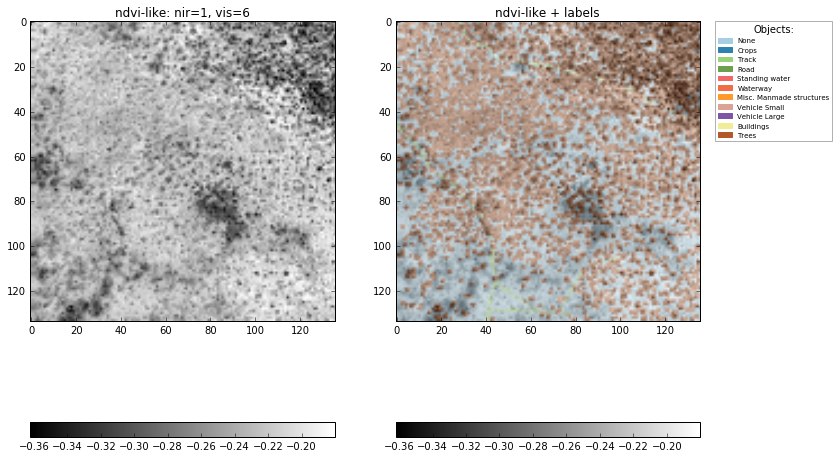

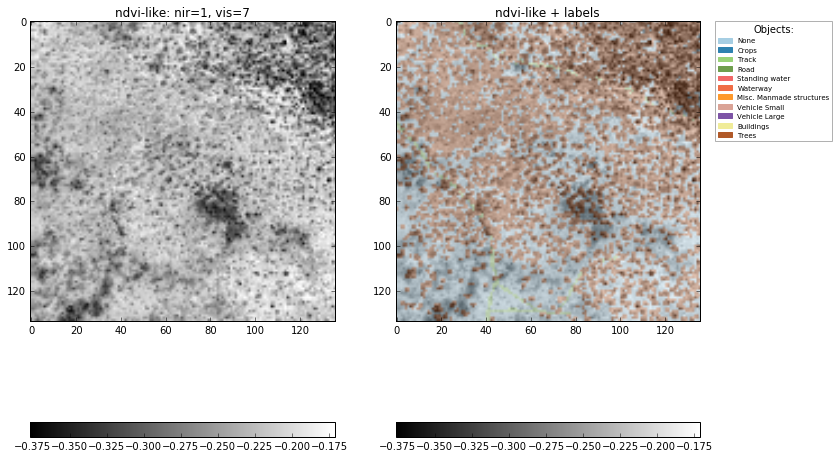

In [58]:
i = 1
for j in range(8):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(img_swir, i, j)
    display_ndvi_like(ndvi_like, label_img_swir, None, 0.35, i, j)    

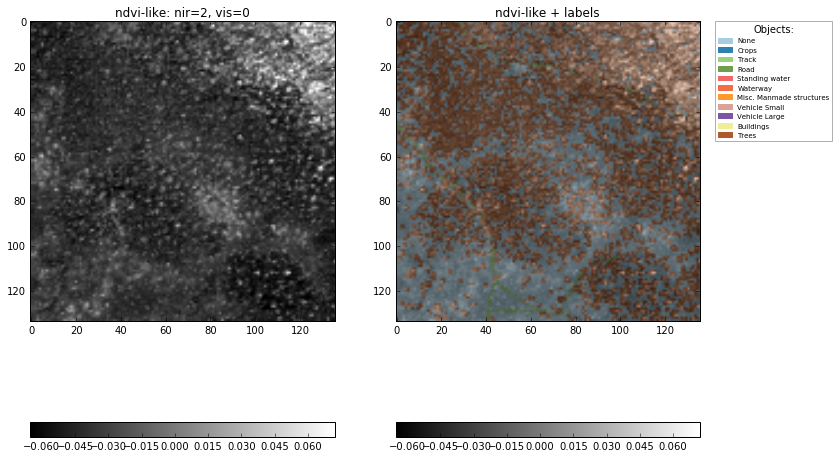

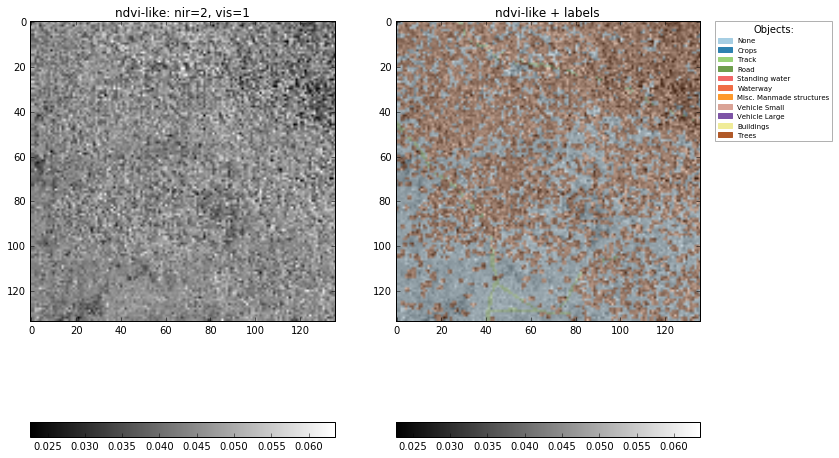

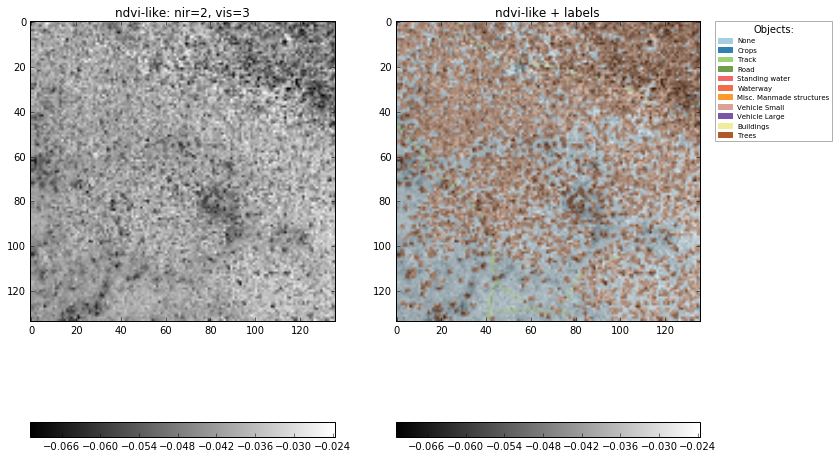

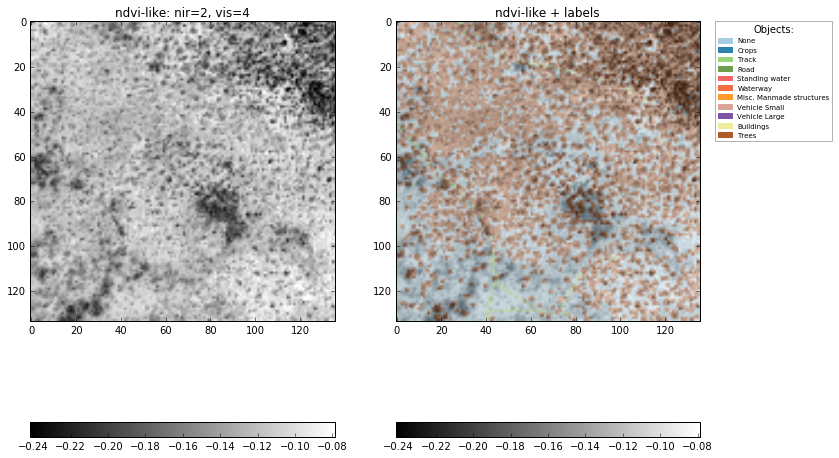

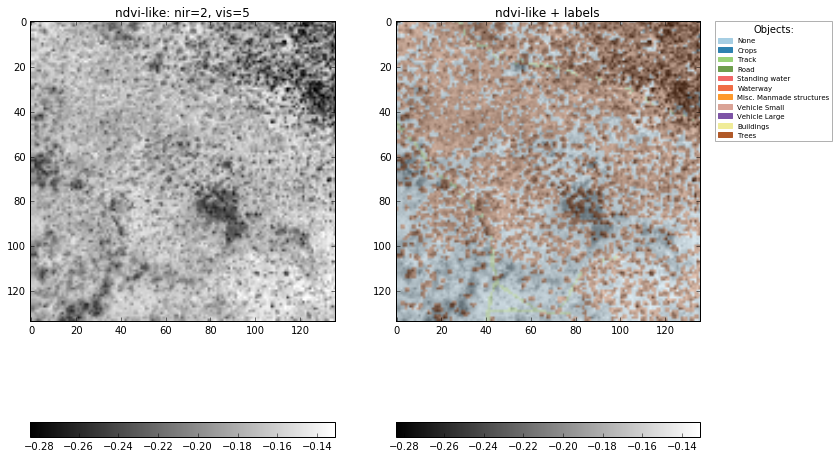

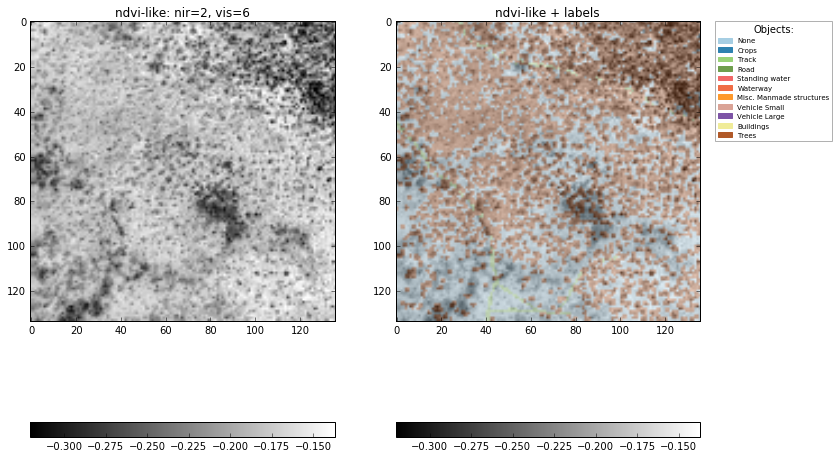

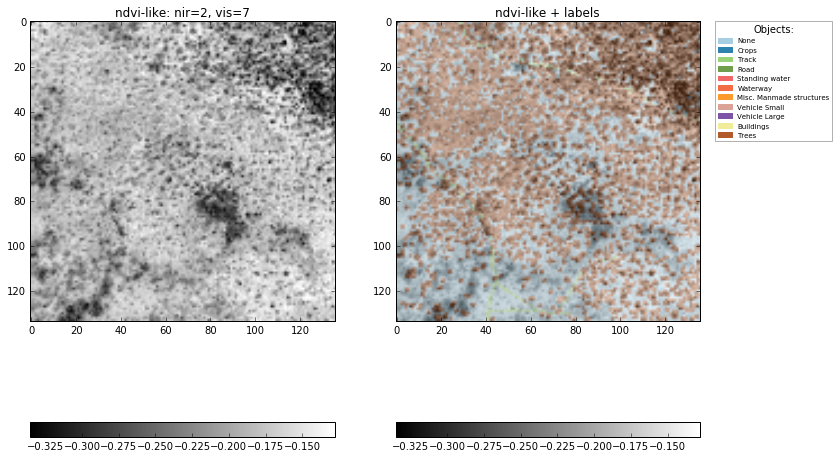

In [59]:
i = 2
for j in range(8):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(img_swir, i, j)
    display_ndvi_like(ndvi_like, label_img_swir, None, 0.35, i, j)    

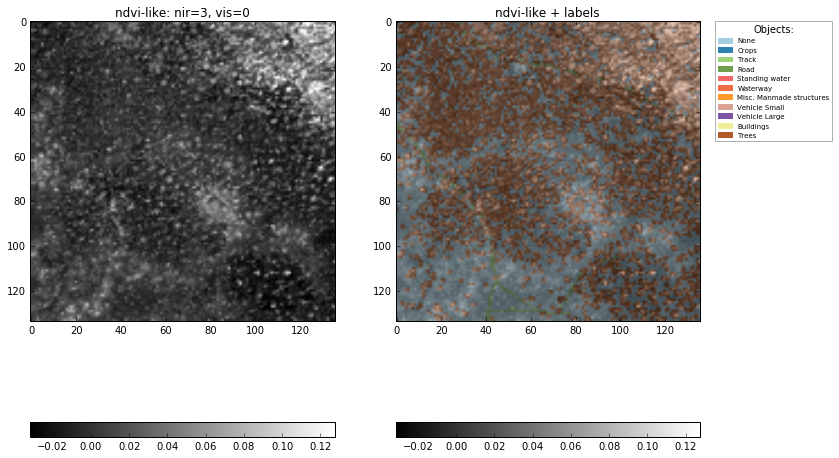

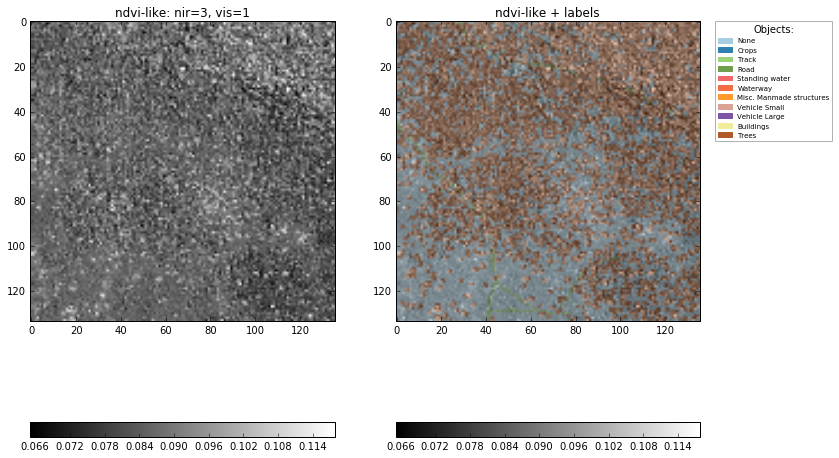

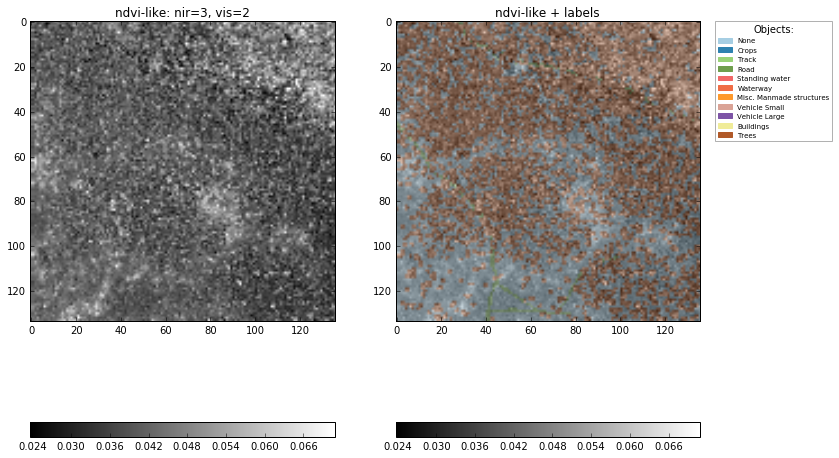

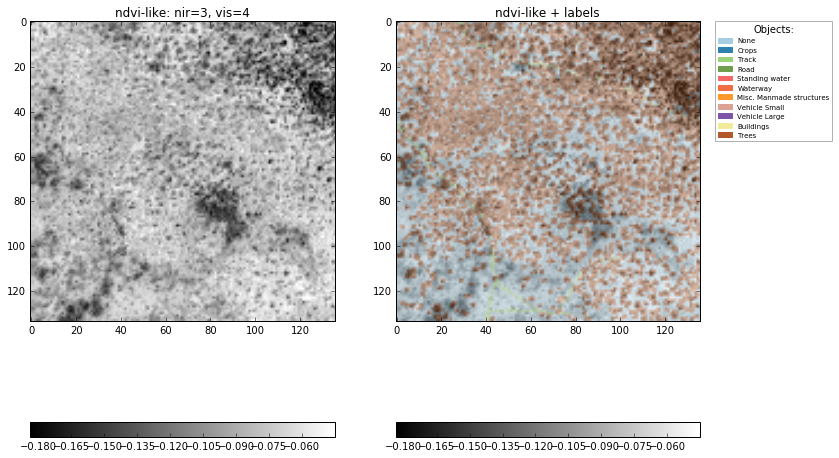

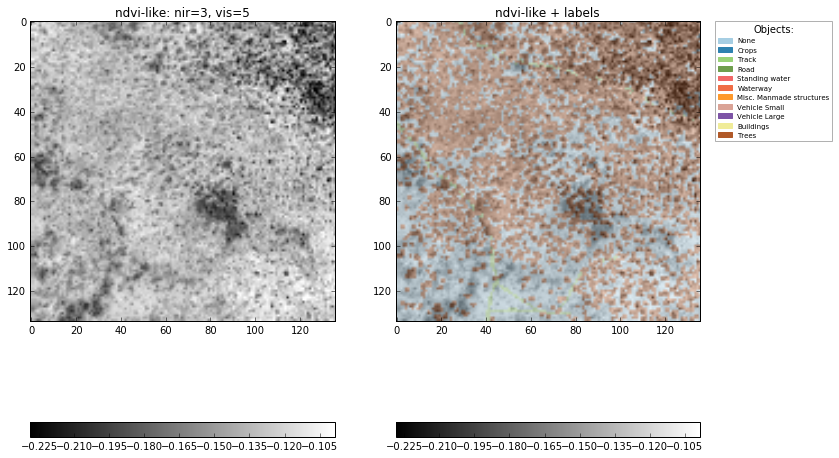

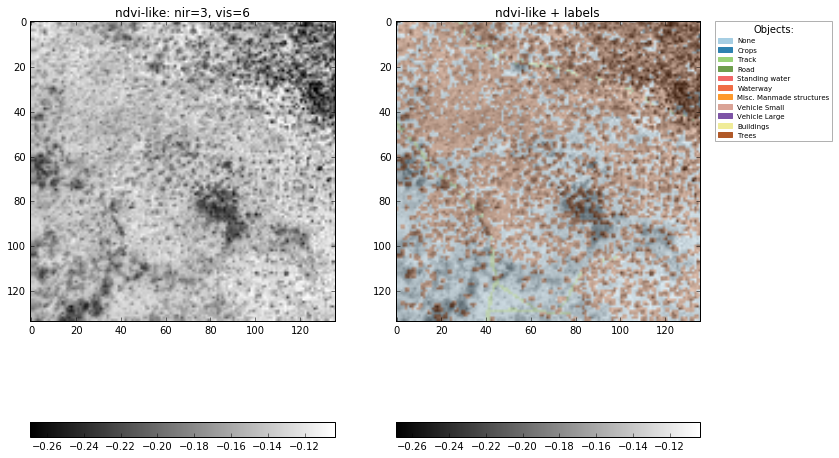

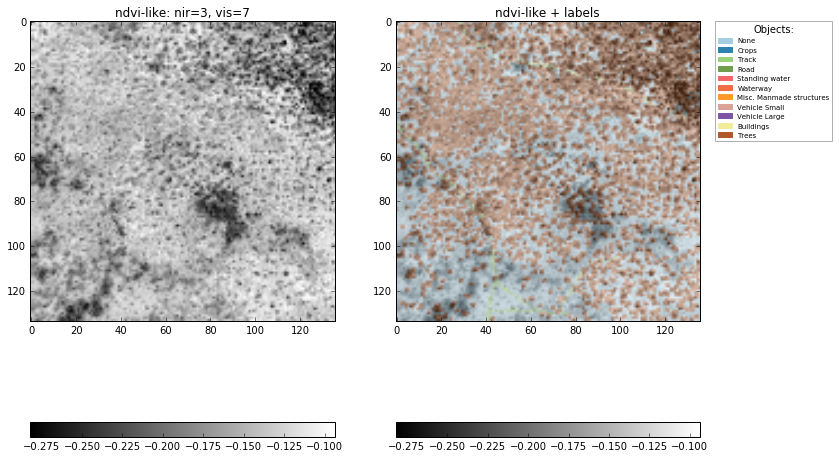

In [60]:
i = 3
for j in range(8):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(img_swir, i, j)
    display_ndvi_like(ndvi_like, label_img_swir, None, 0.35, i, j)    

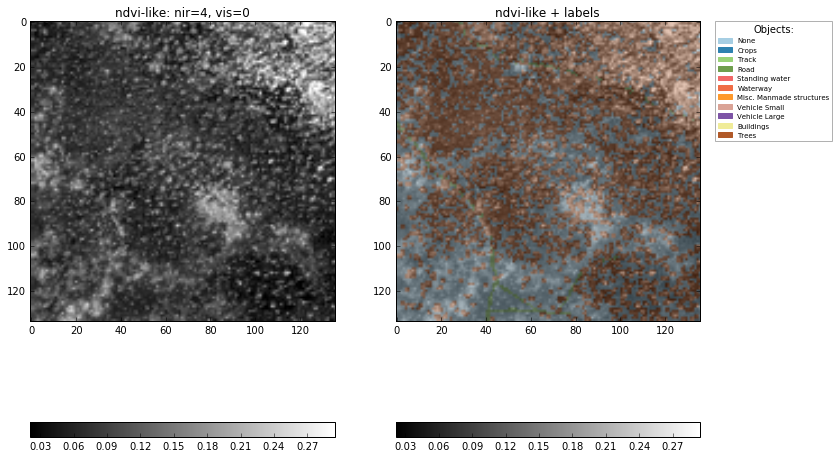

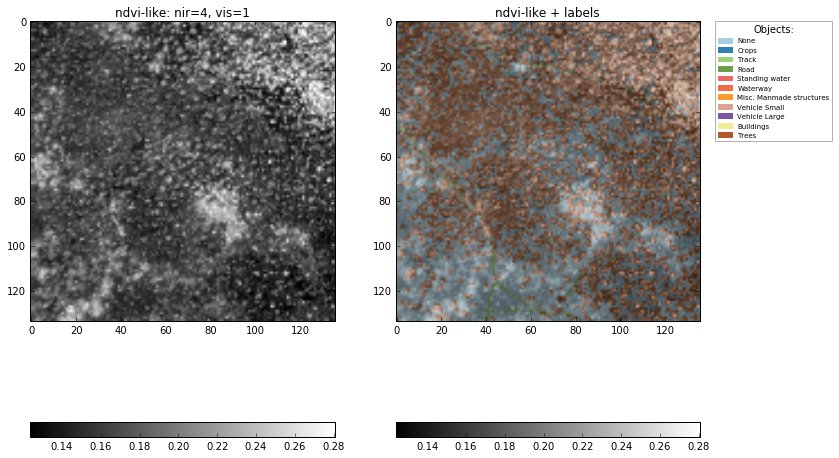

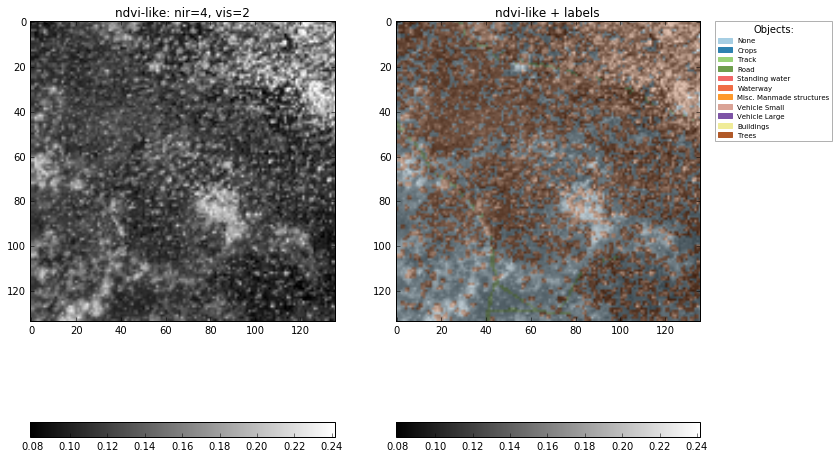

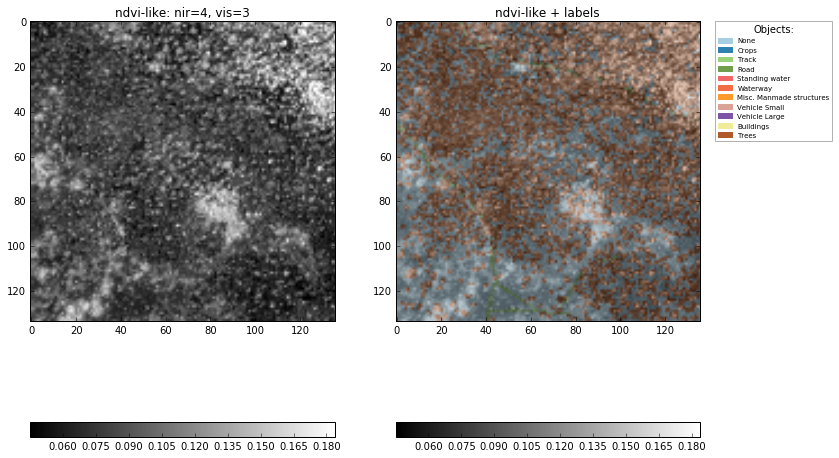

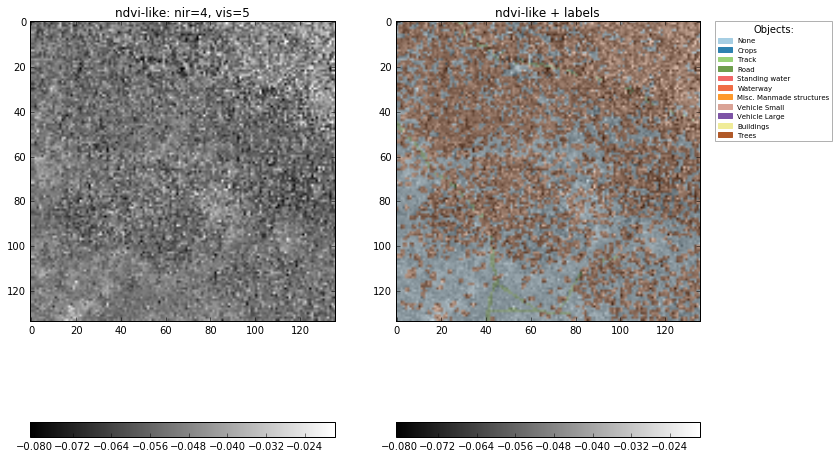

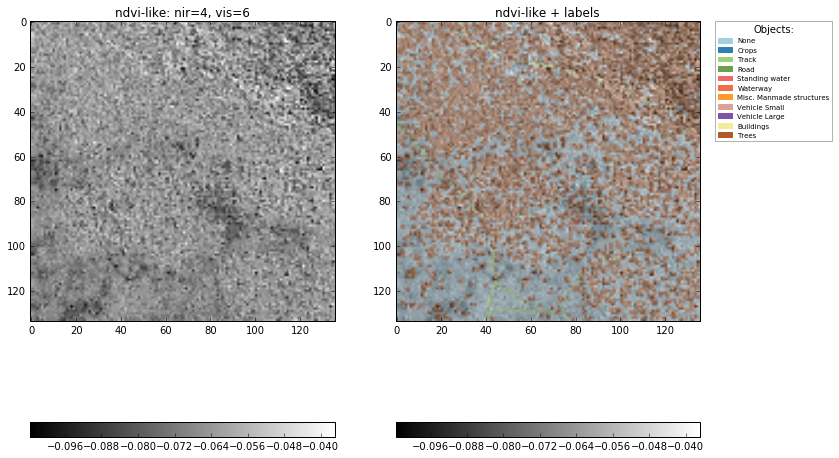

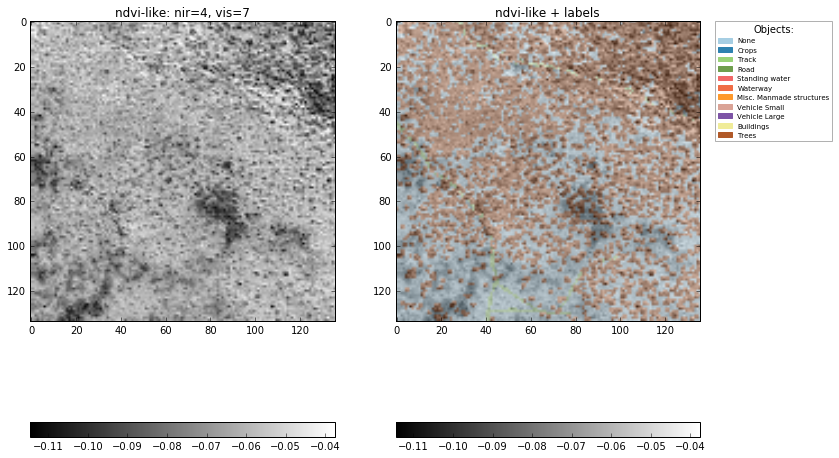

In [61]:
i = 4
for j in range(8):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(img_swir, i, j)
    display_ndvi_like(ndvi_like, label_img_swir, None, 0.35, i, j)    

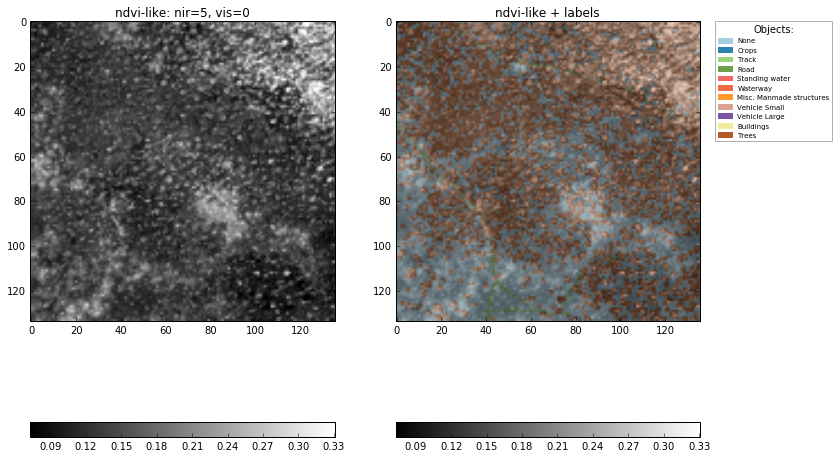

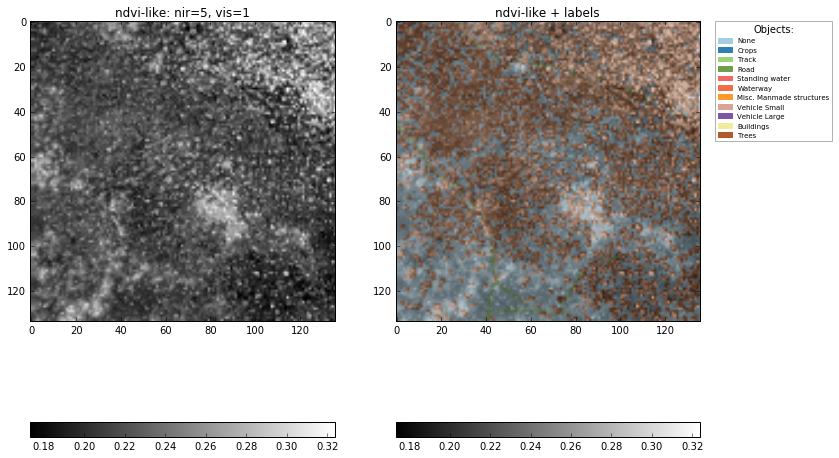

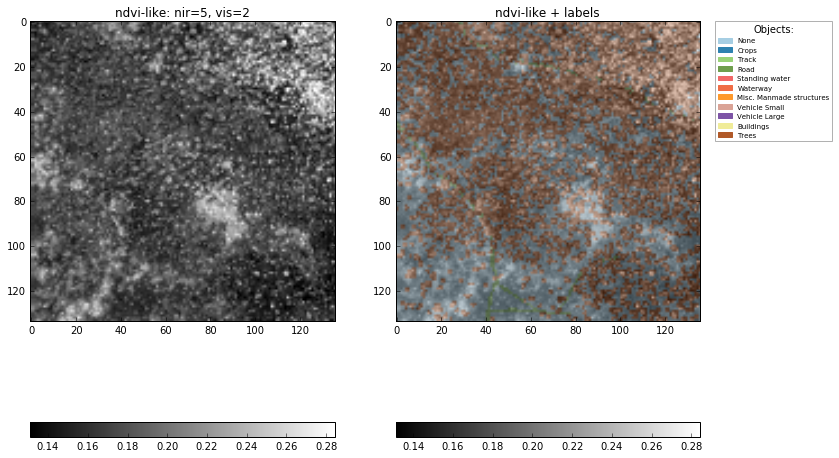

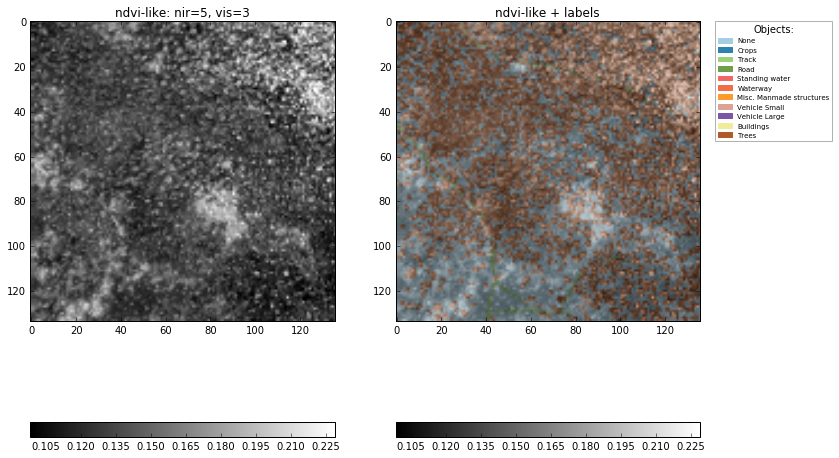

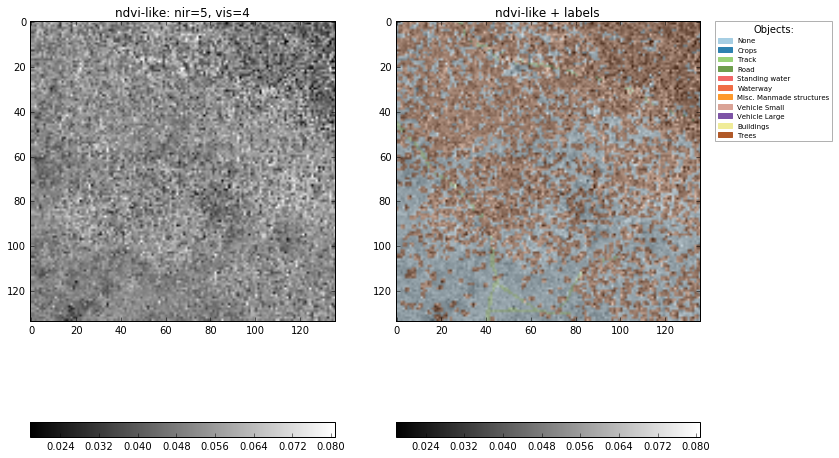

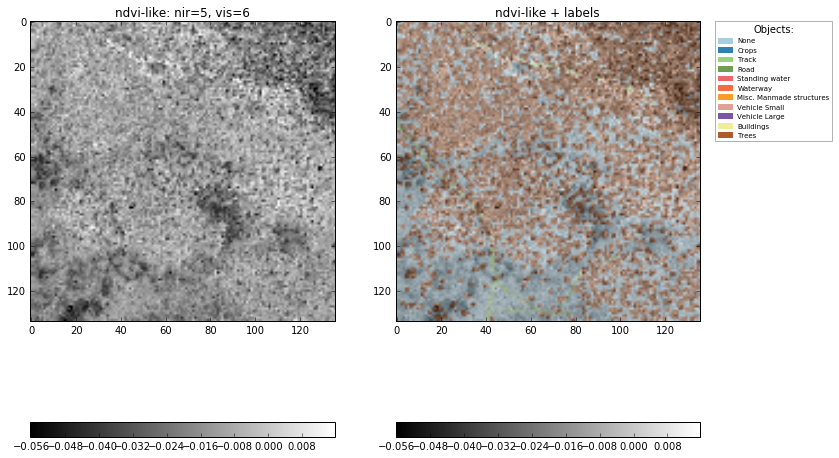

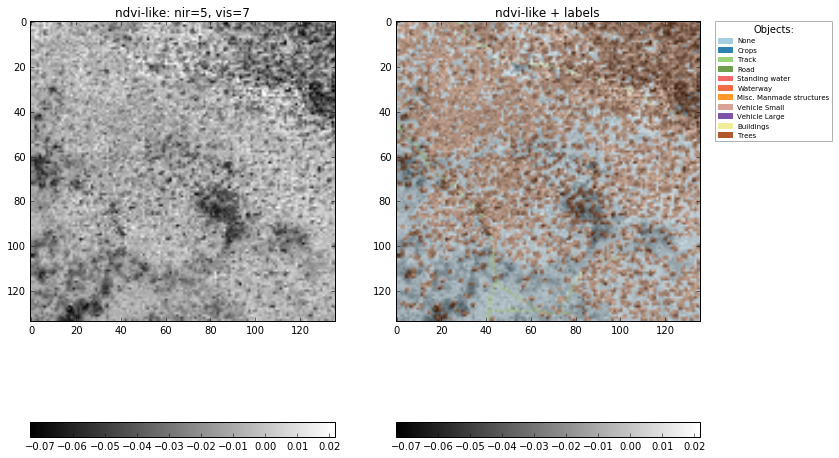

In [62]:
i = 5
for j in range(8):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(img_swir, i, j)
    display_ndvi_like(ndvi_like, label_img_swir, None, 0.35, i, j)    

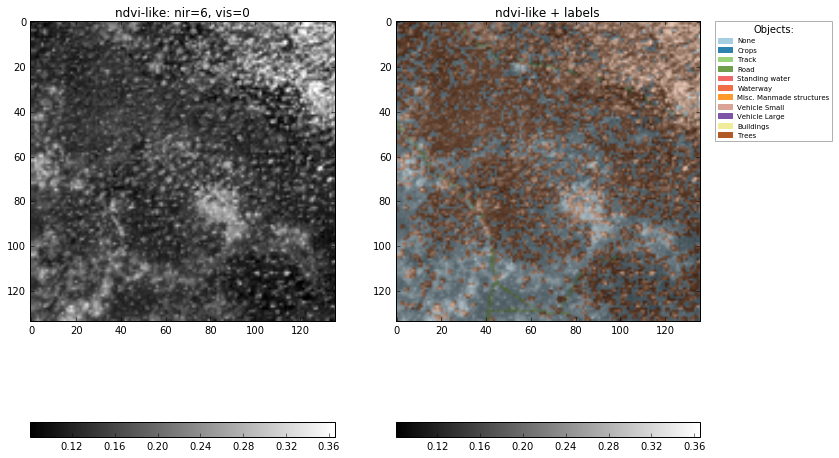

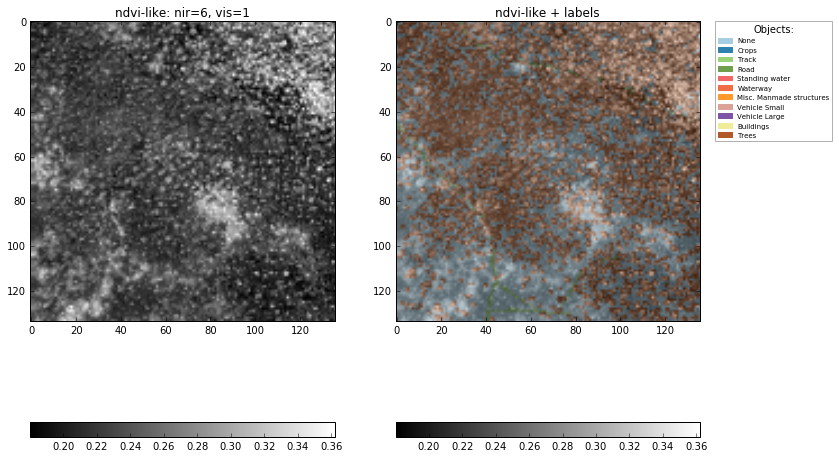

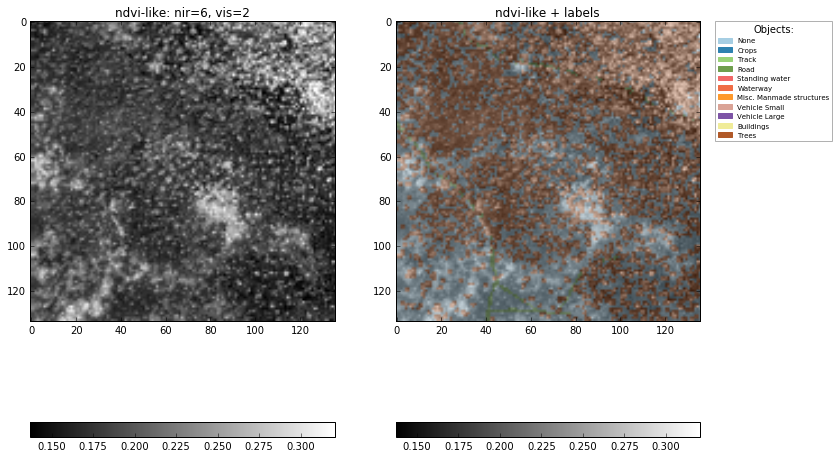

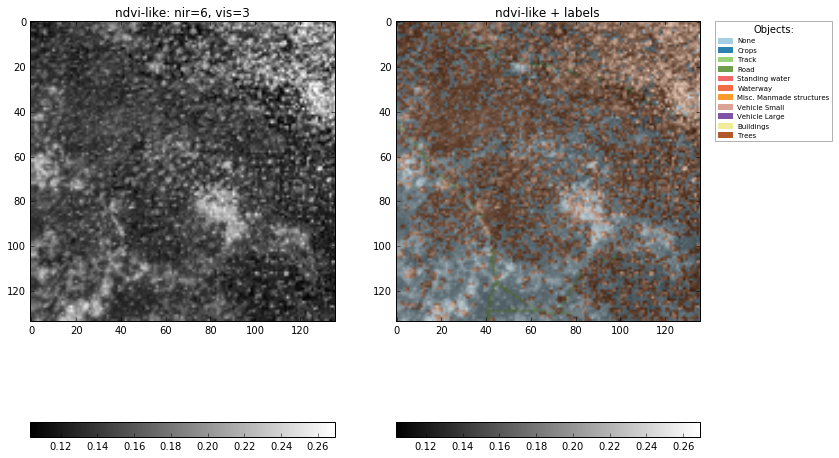

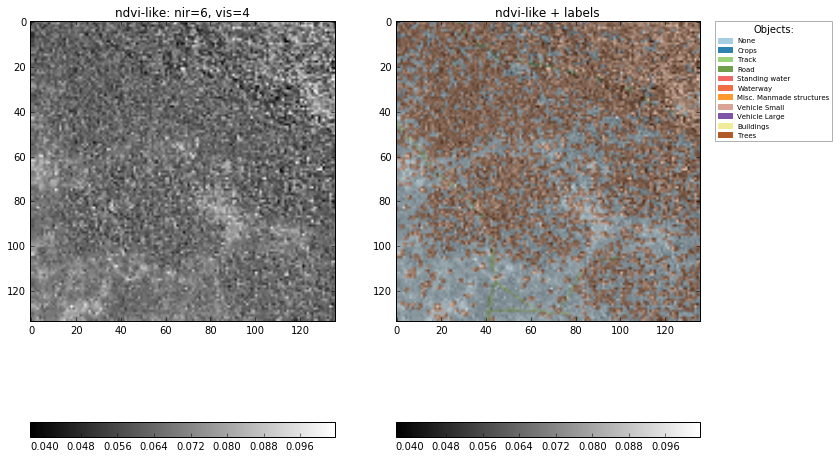

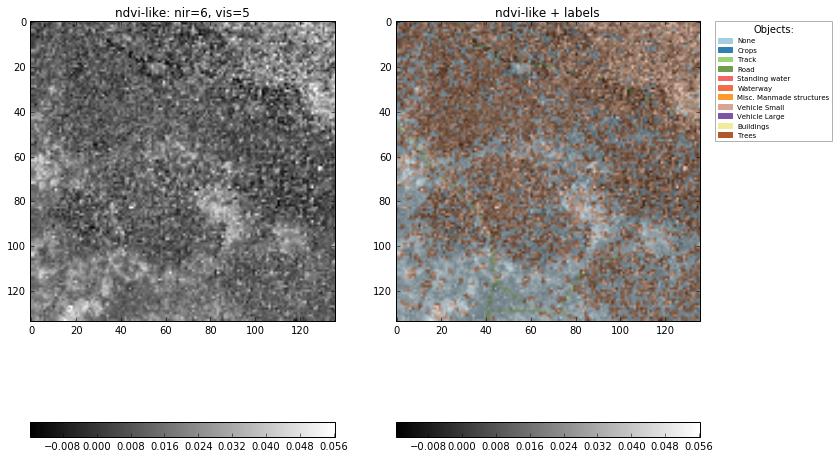

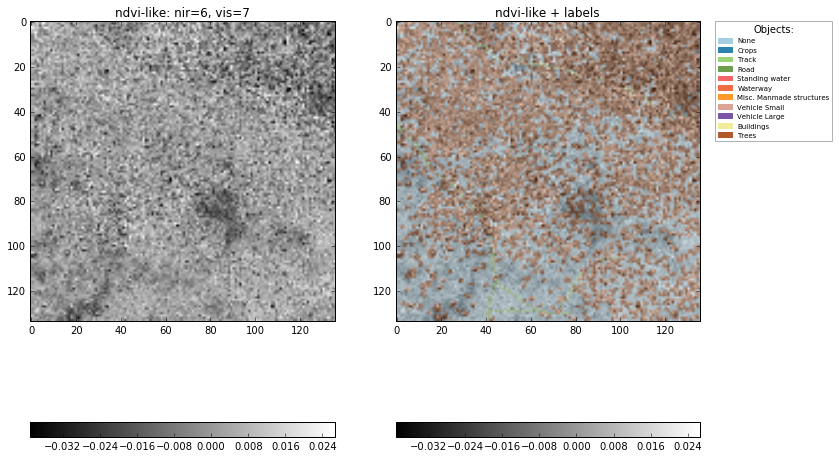

In [63]:
i = 6
for j in range(8):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(img_swir, i, j)
    display_ndvi_like(ndvi_like, label_img_swir, None, 0.35, i, j)  

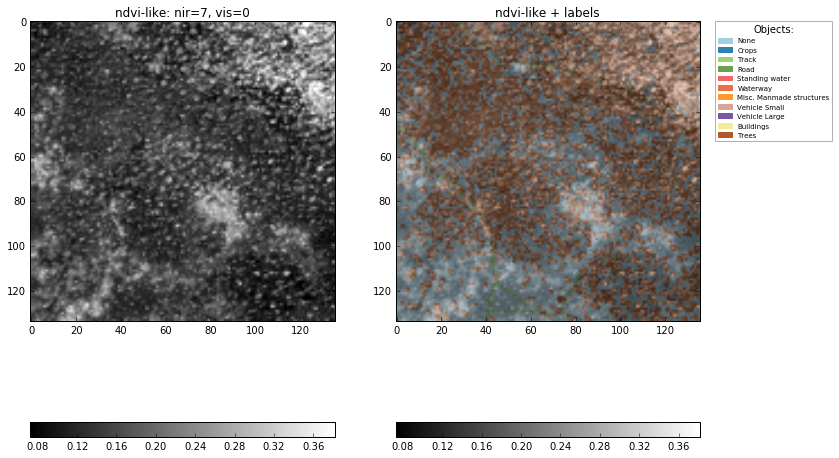

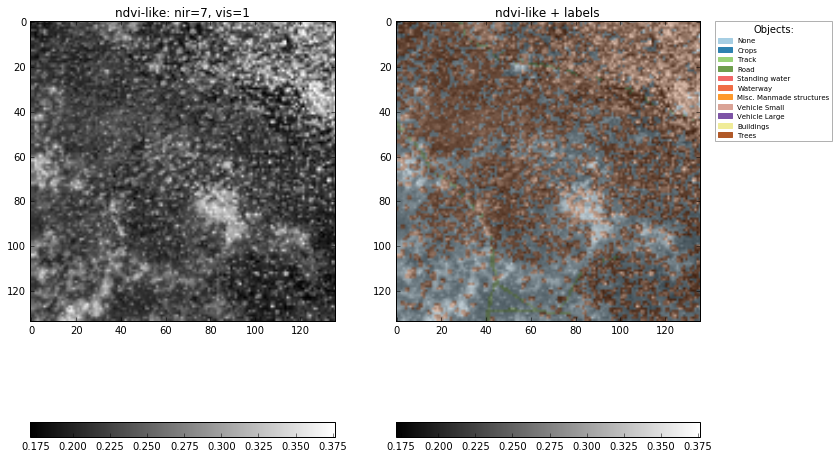

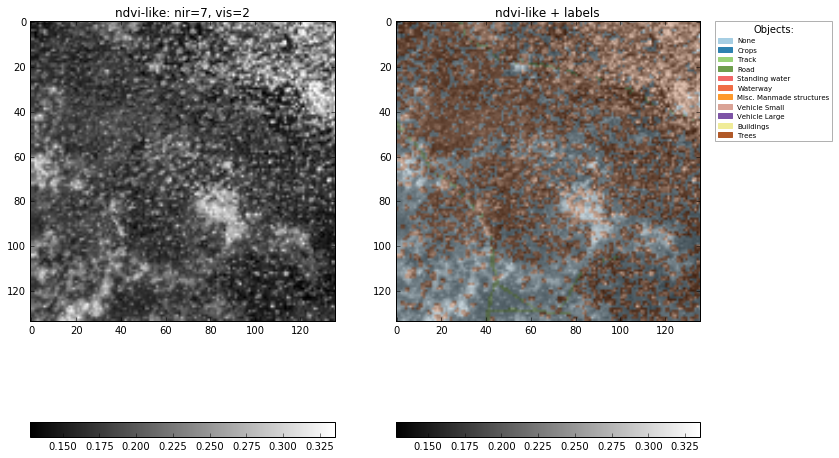

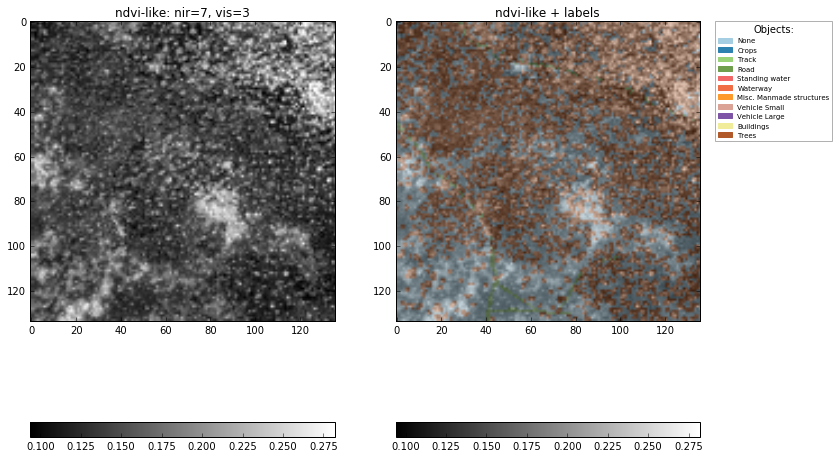

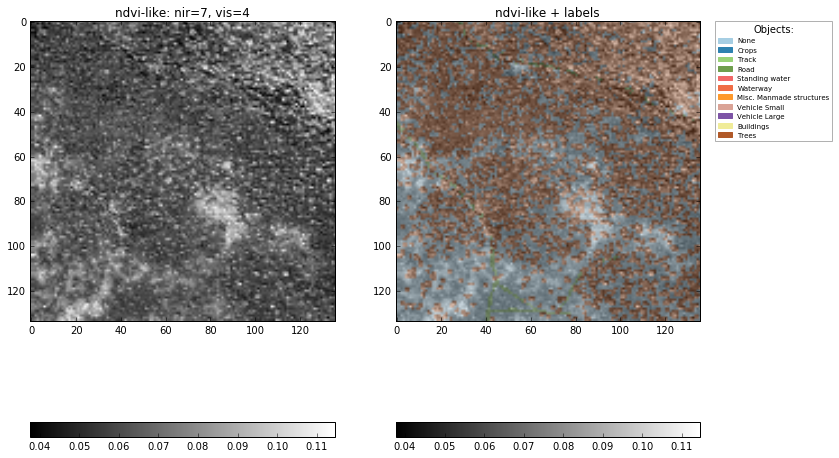

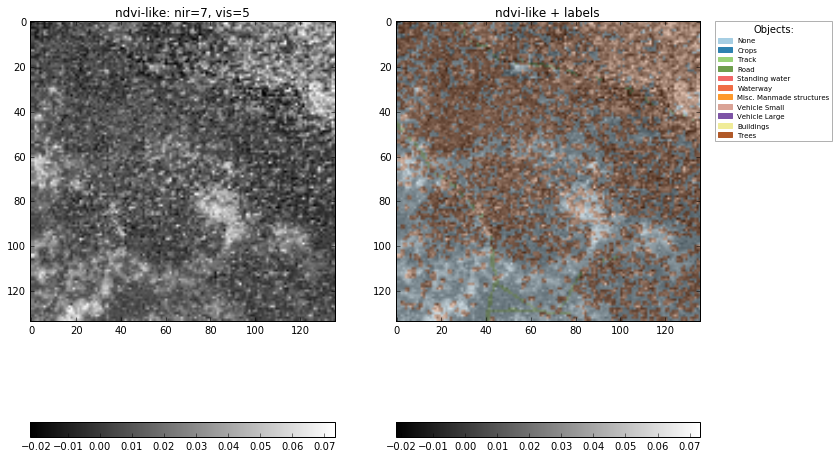

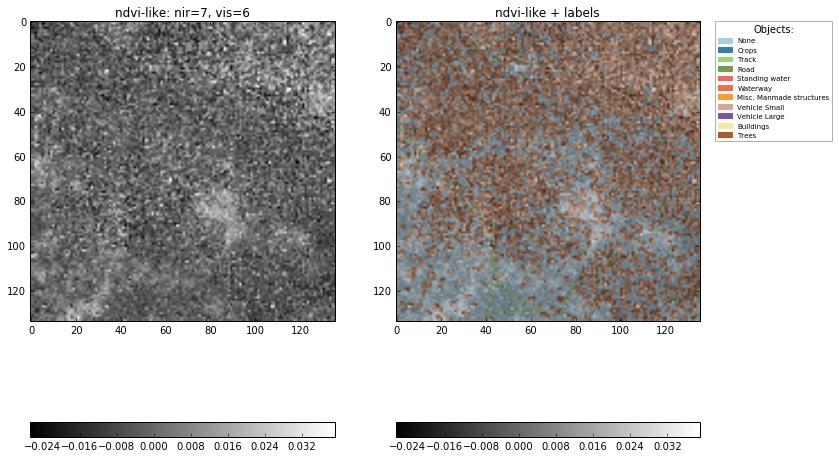

In [64]:
i = 7
for j in range(8):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(img_swir, i, j)
    display_ndvi_like(ndvi_like, label_img_swir, None, 0.35, i, j)    

NDVI-like ratios between SWIR channels

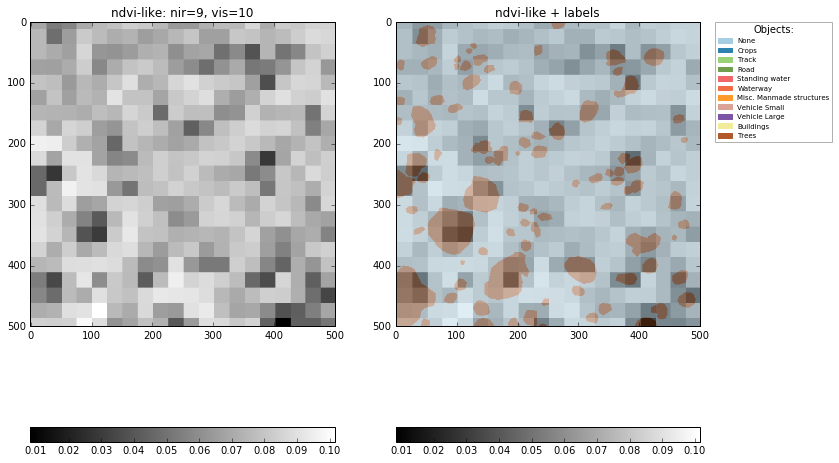

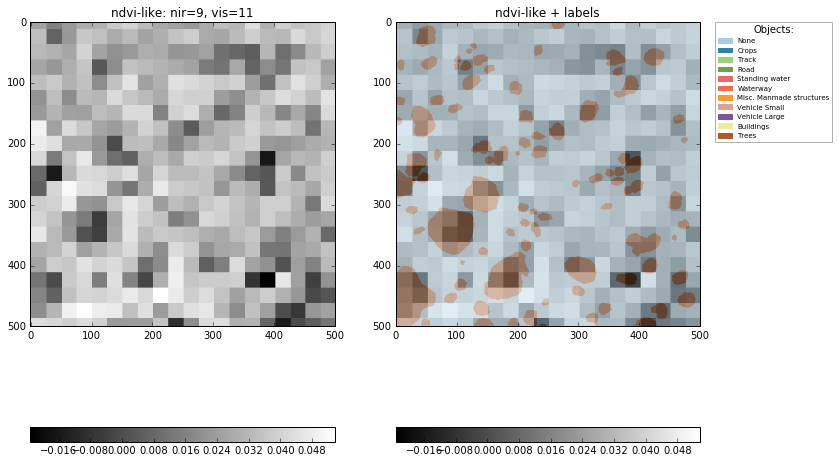

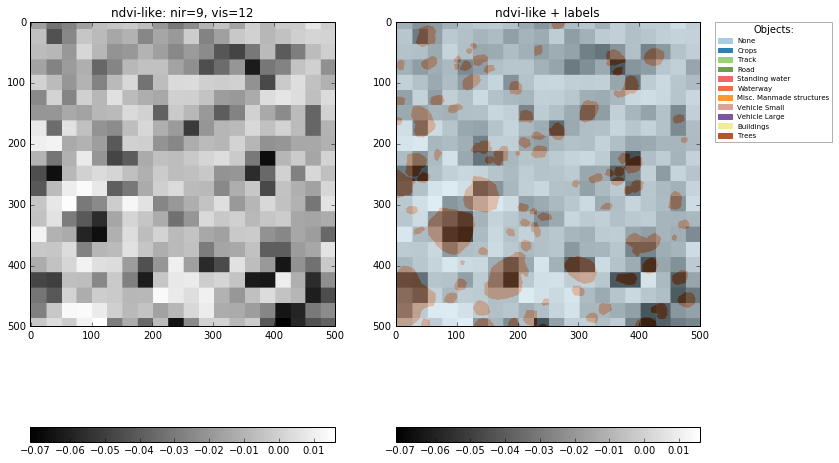

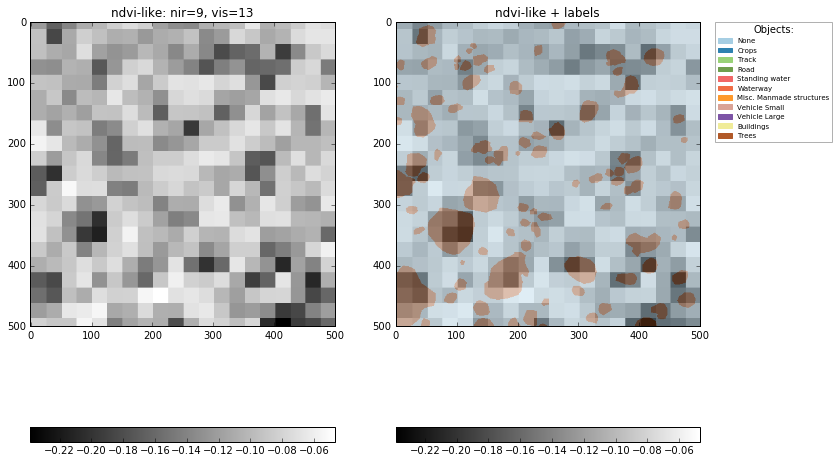

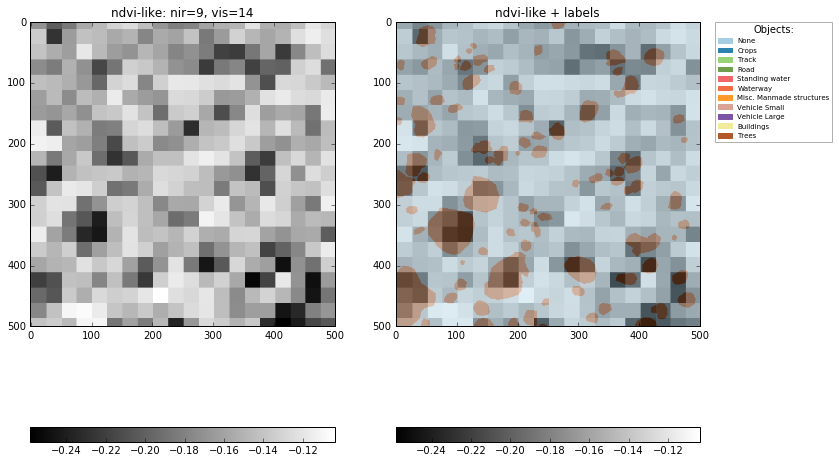

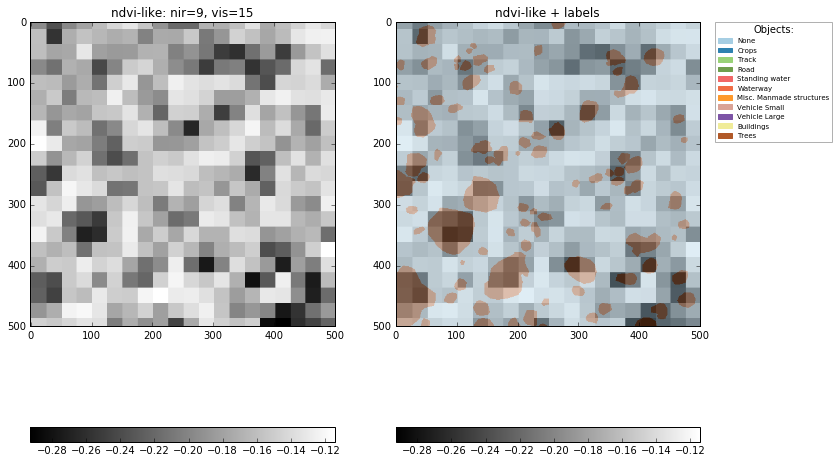

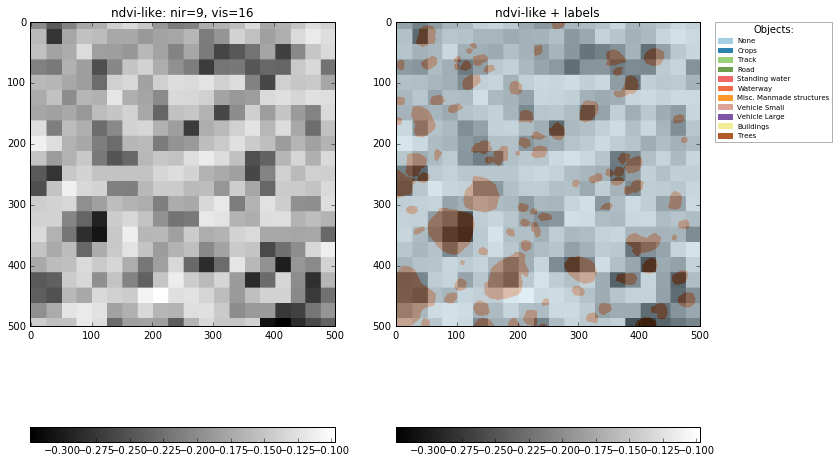

In [57]:
i = 9
for j in range(9,17):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

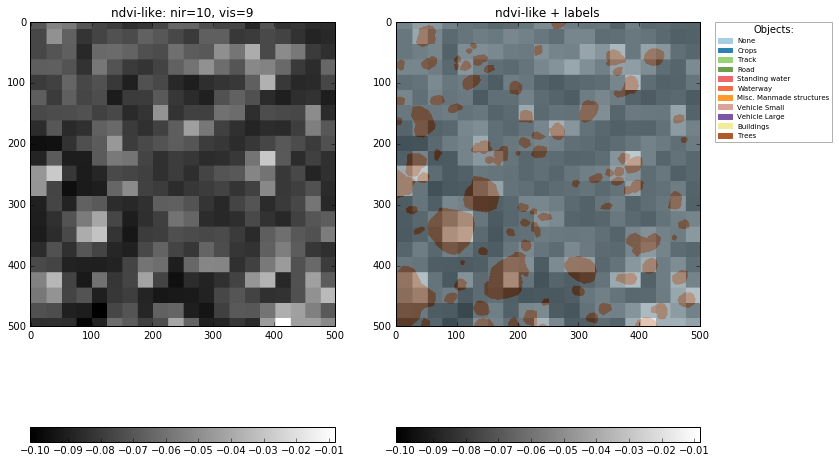

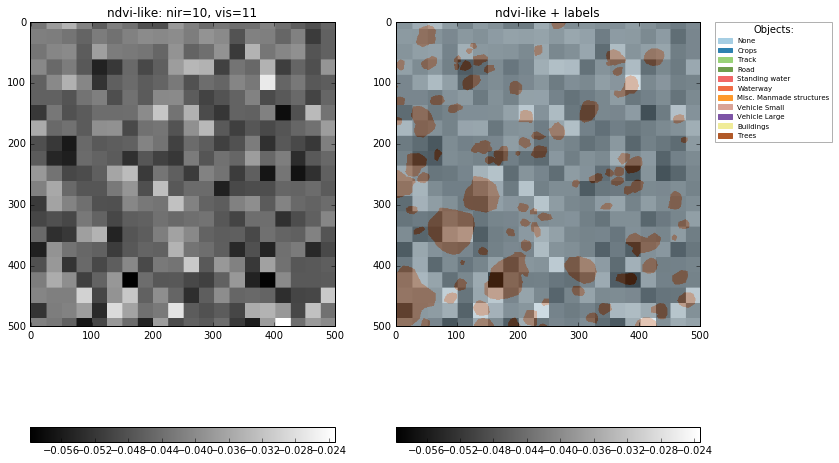

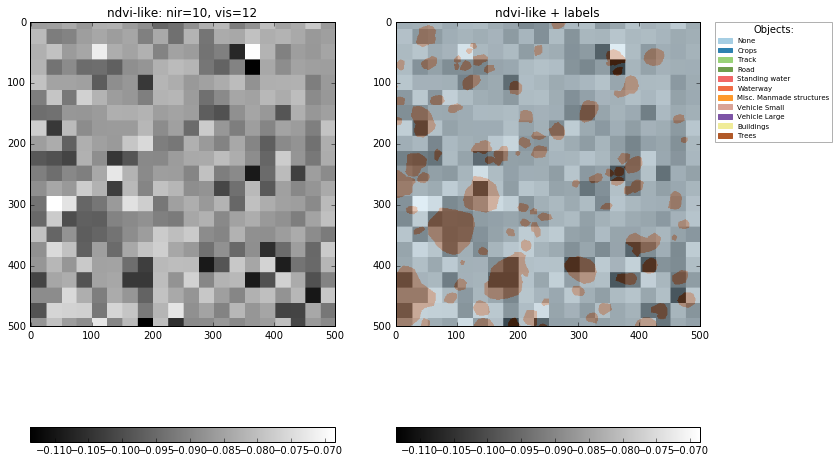

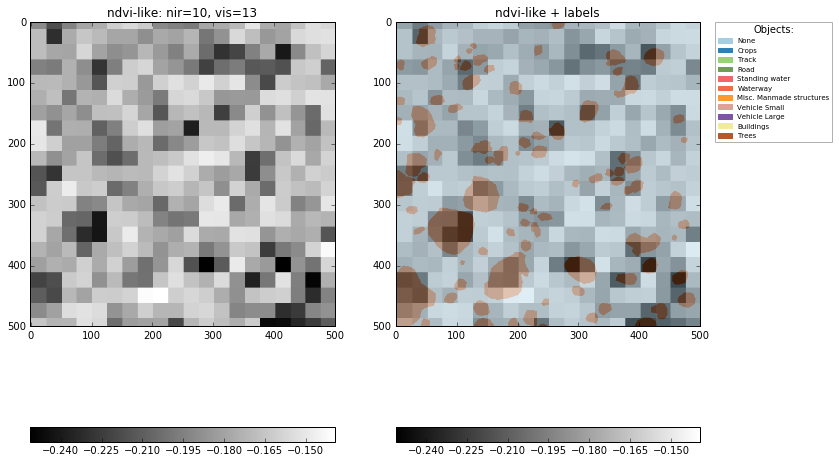

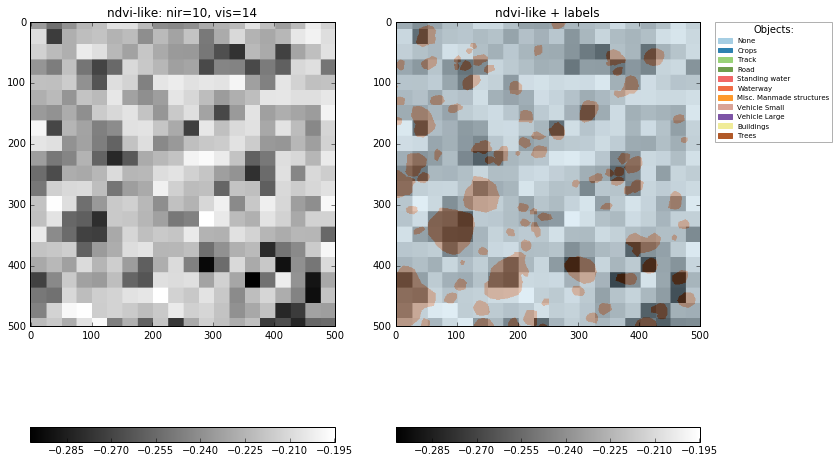

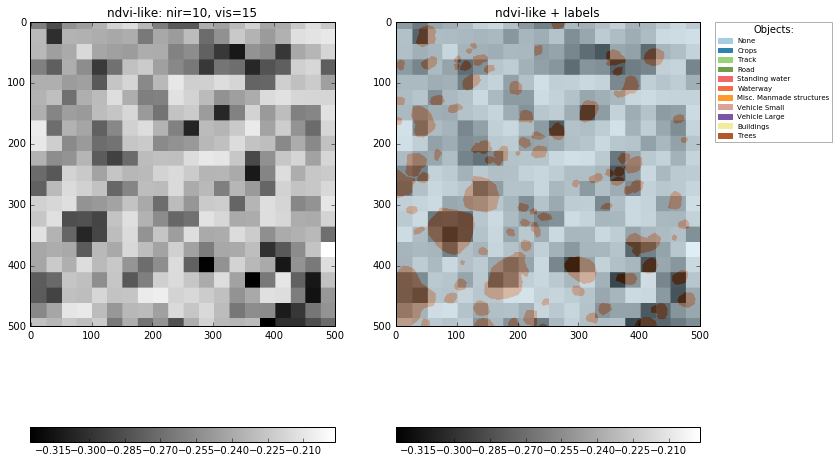

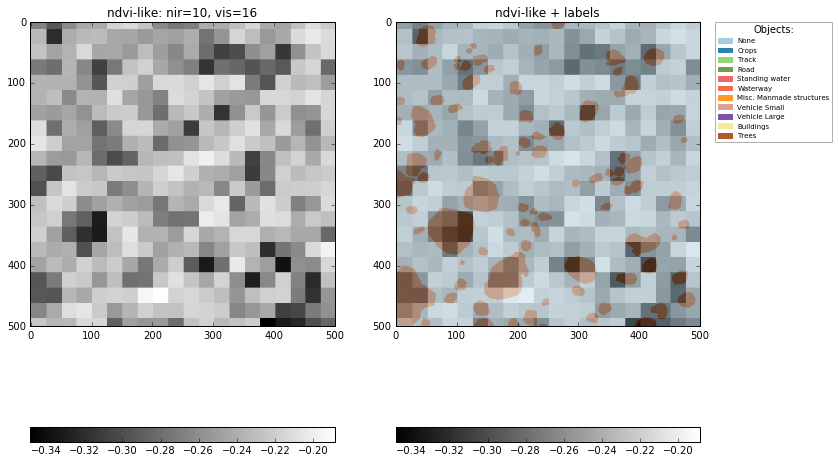

In [29]:
i = 10
for j in range(9,17):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

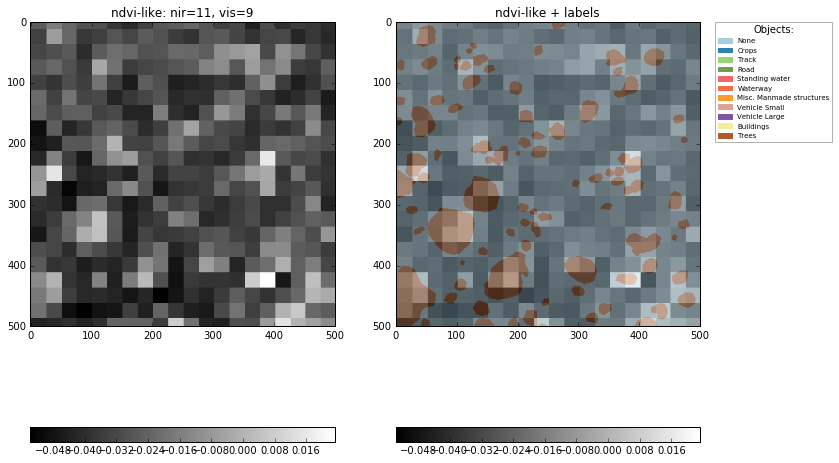

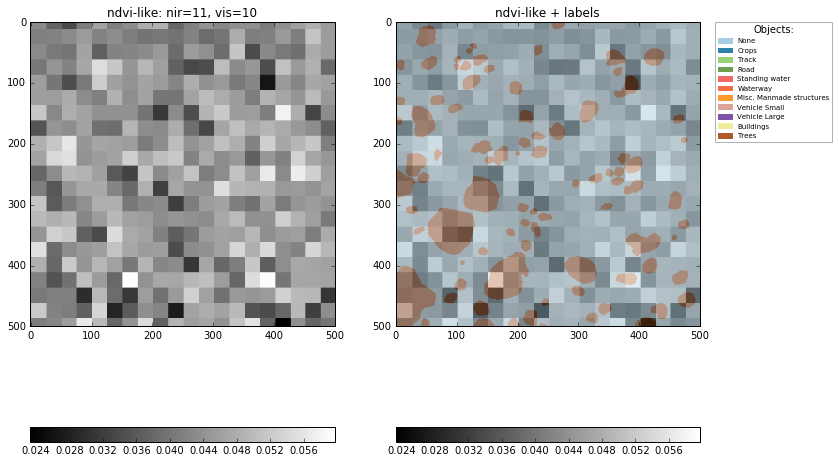

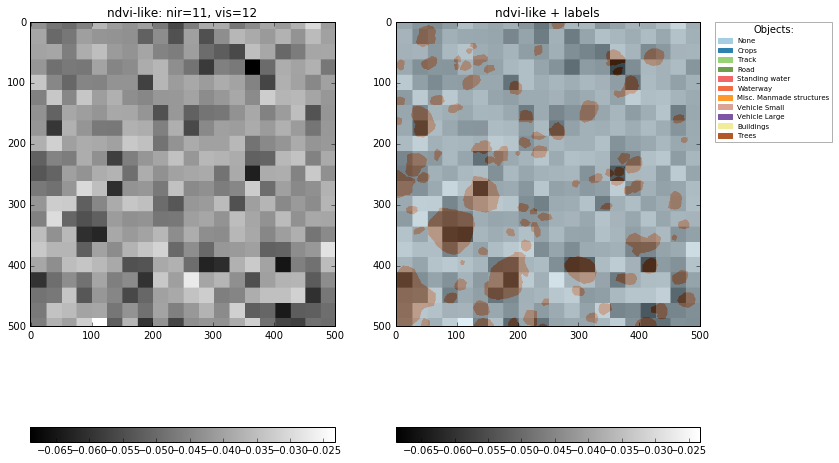

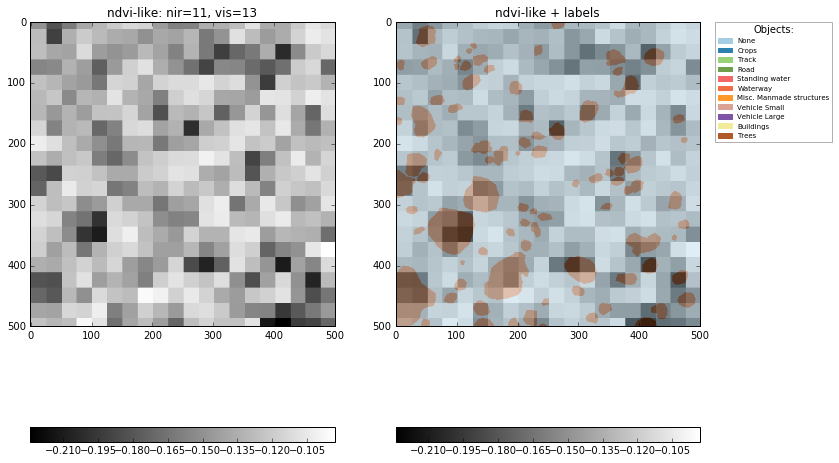

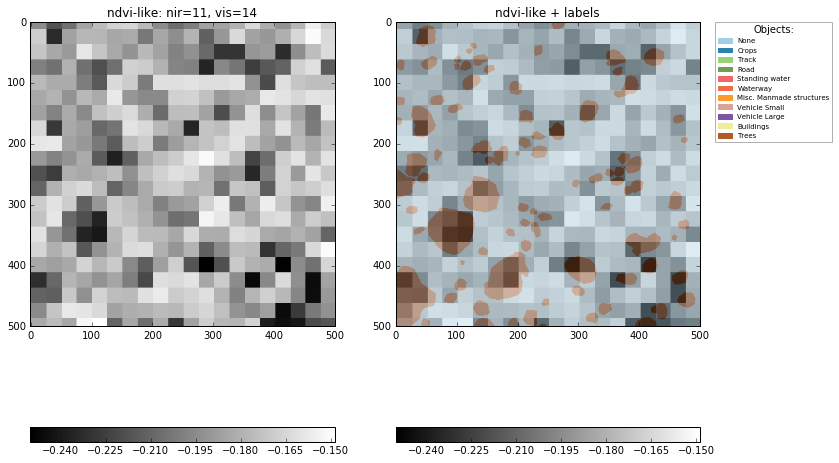

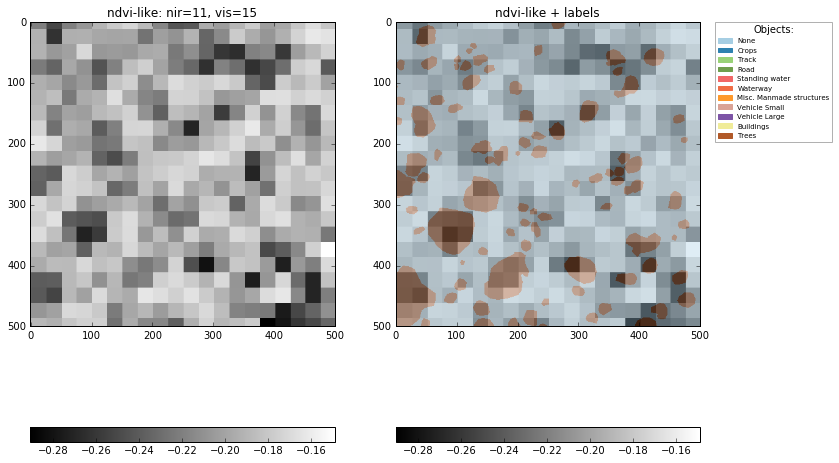

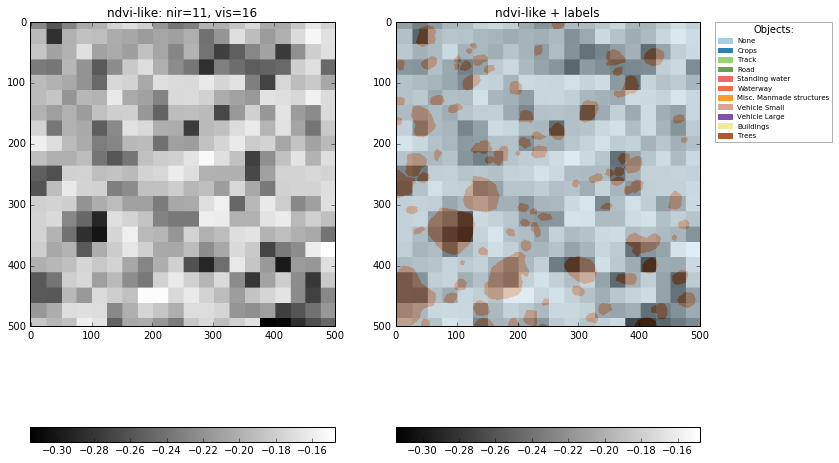

In [30]:
i = 11
for j in range(9,17):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

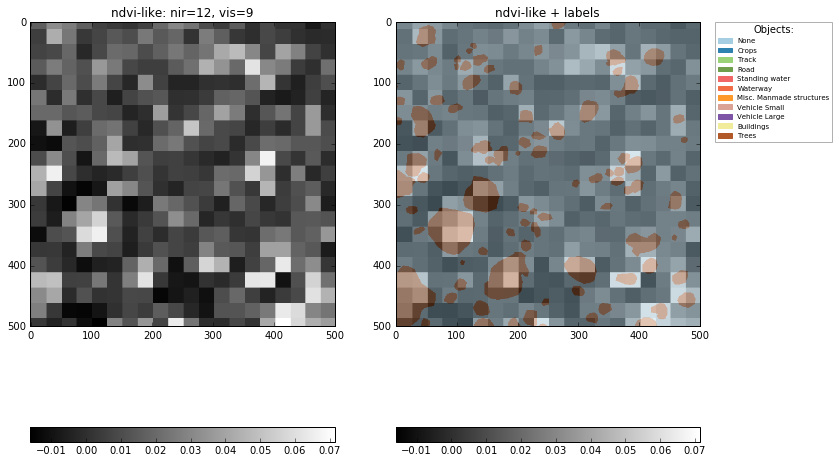

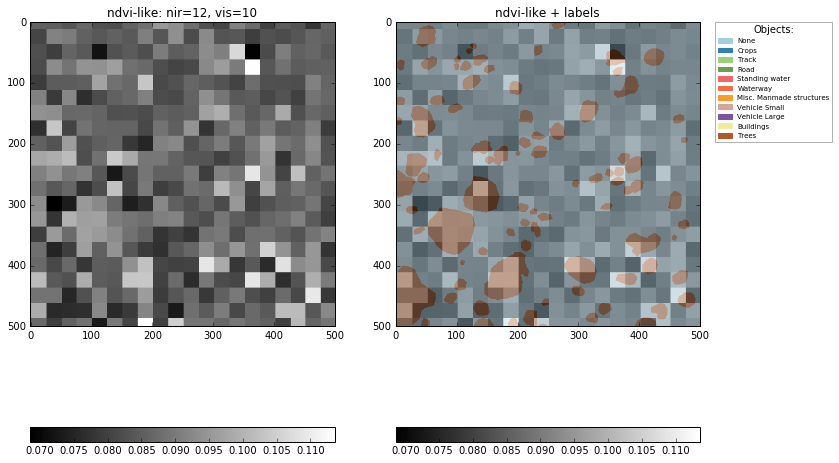

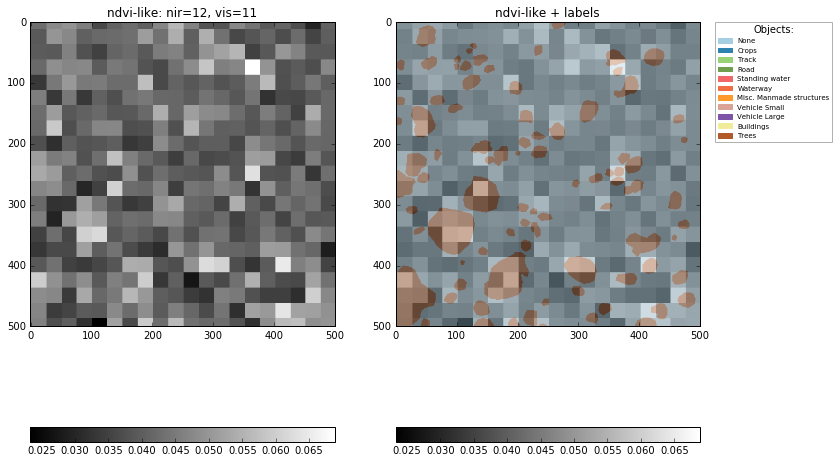

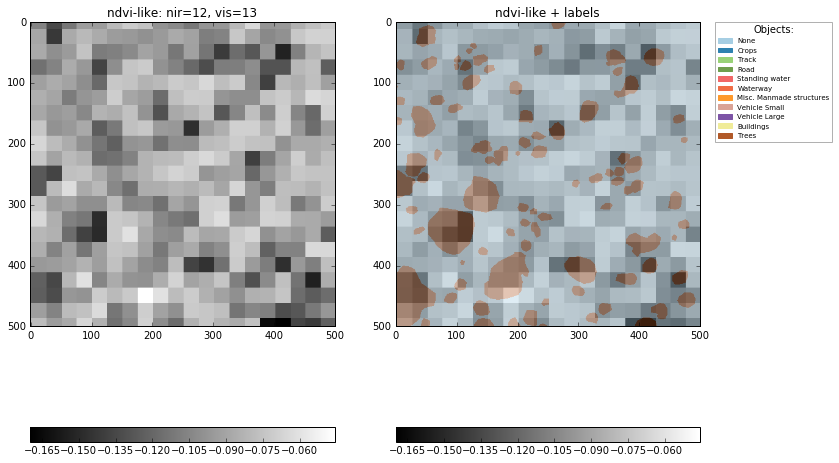

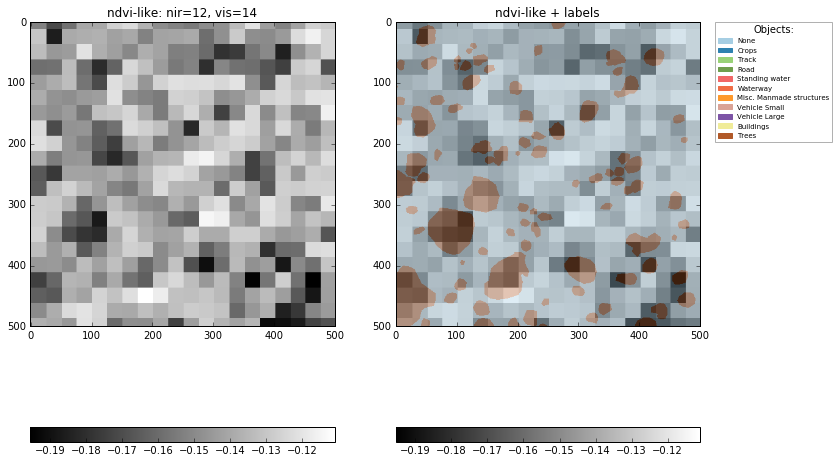

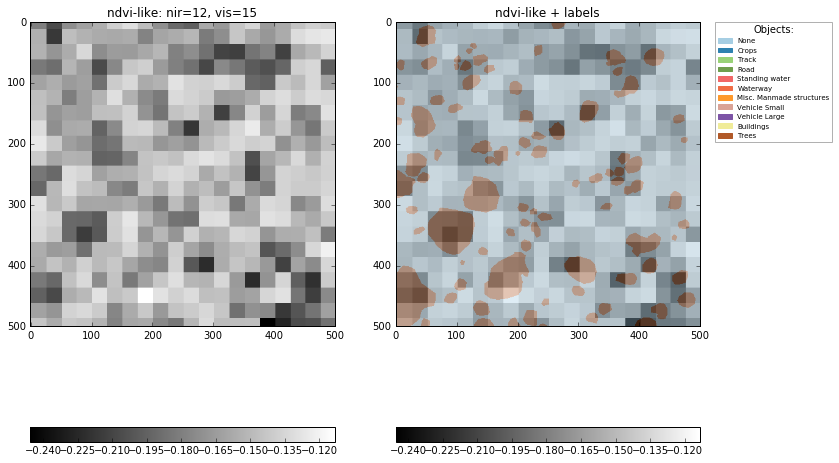

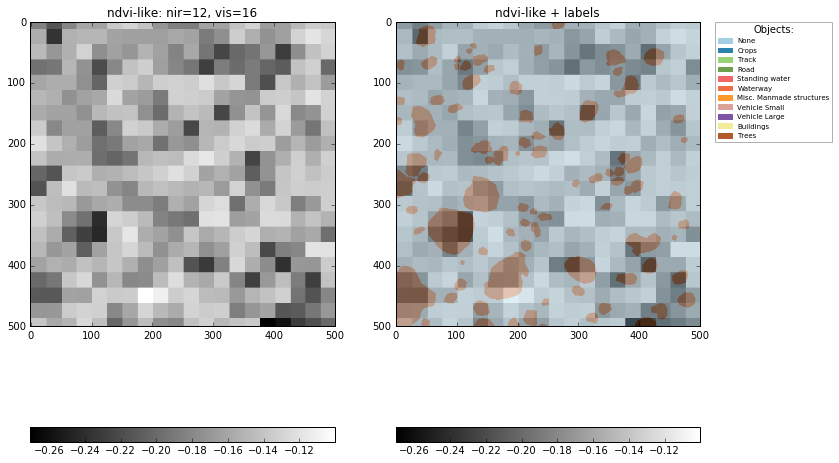

In [31]:
i = 12
for j in range(9,17):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

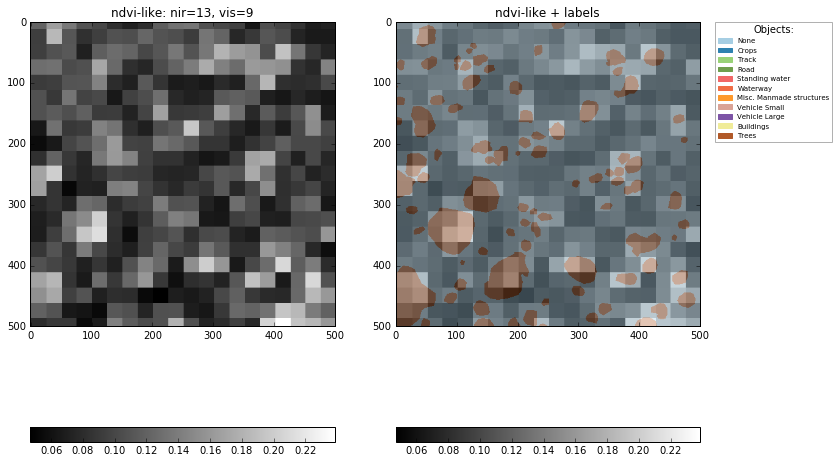

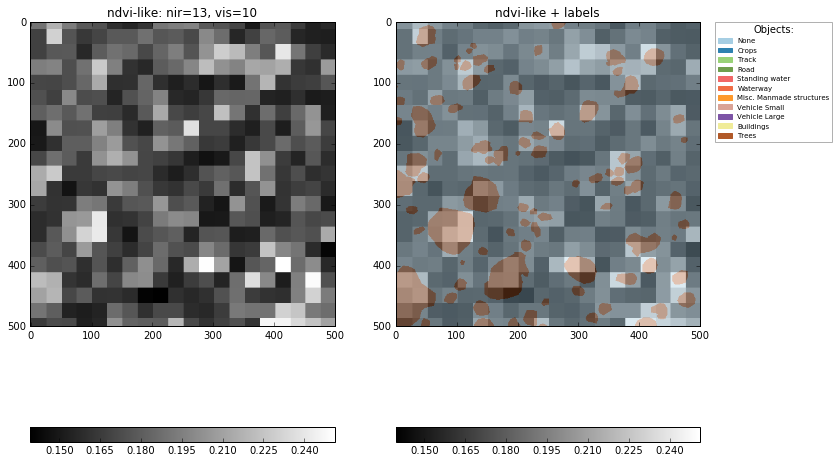

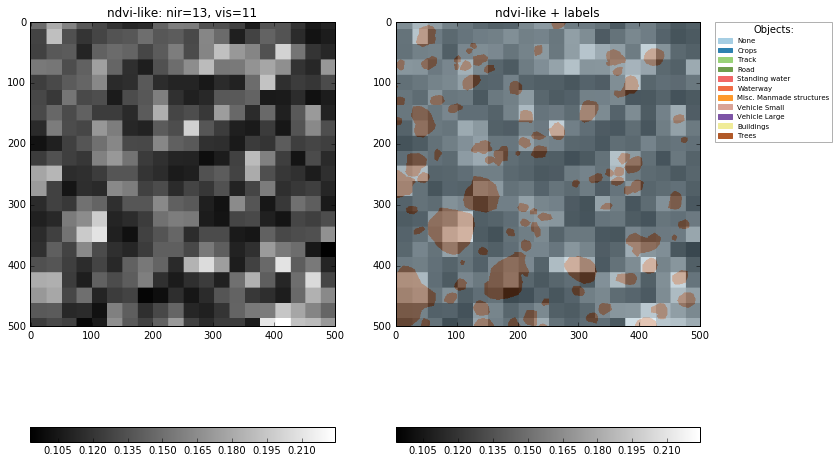

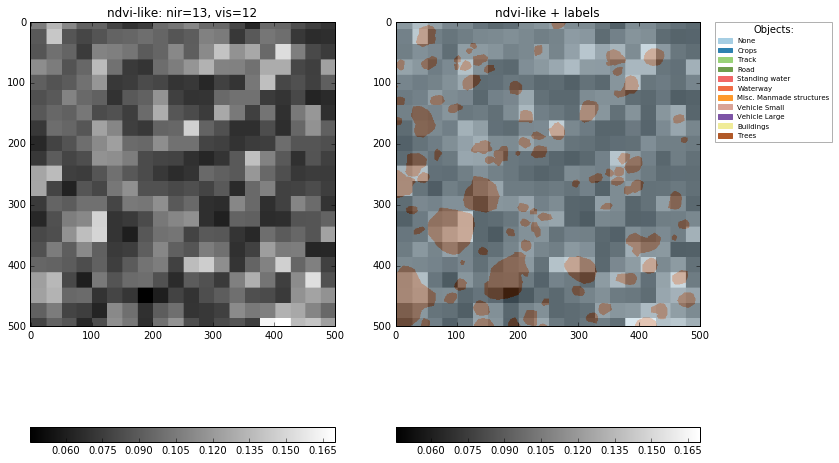

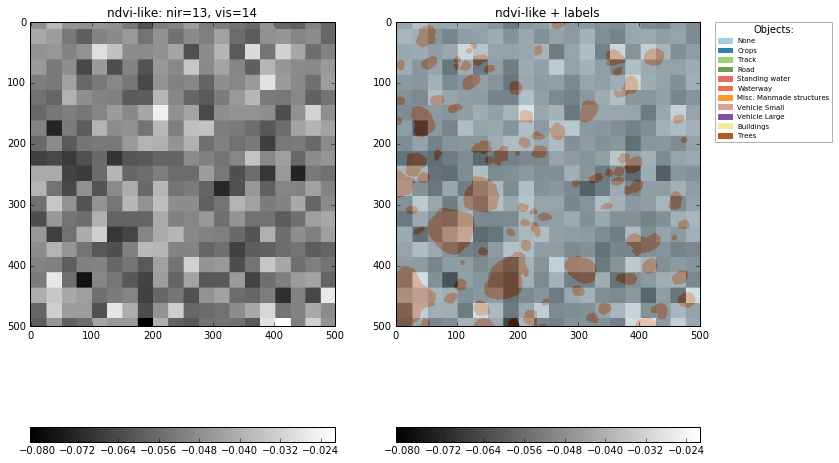

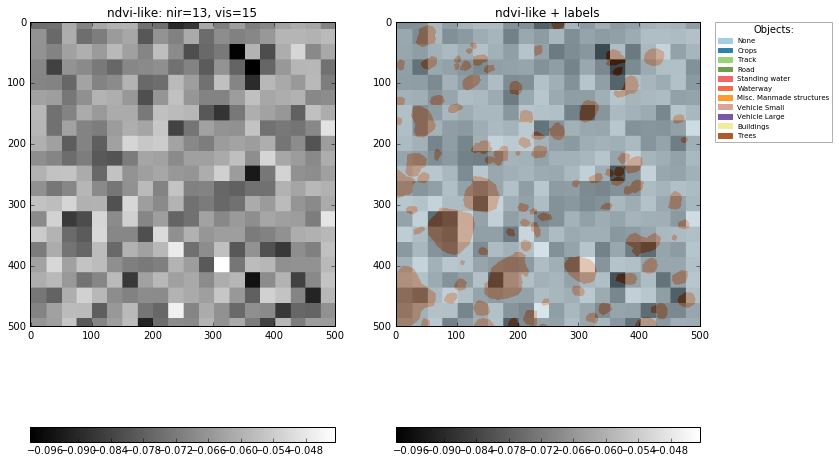

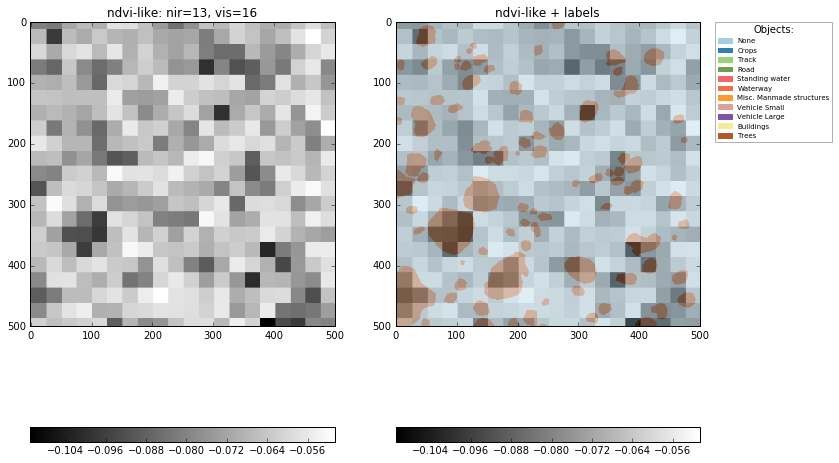

In [32]:
i = 13
for j in range(9,17):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

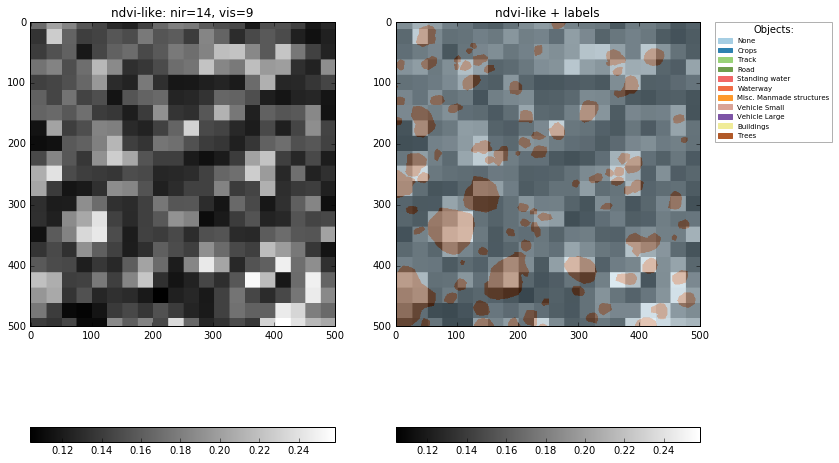

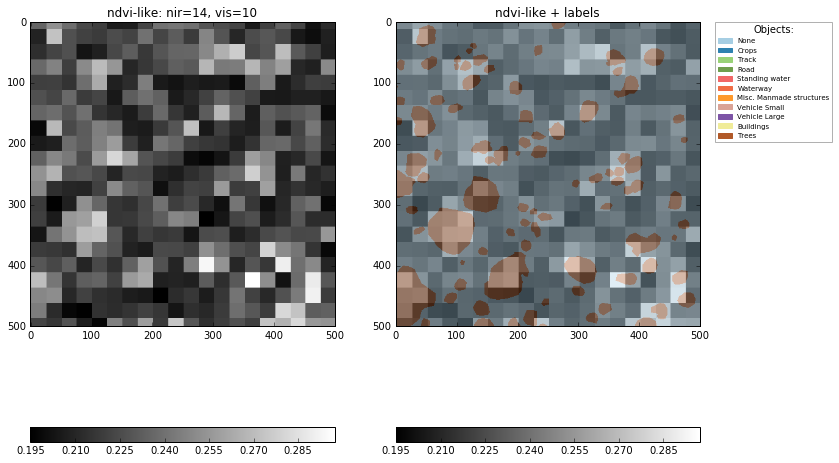

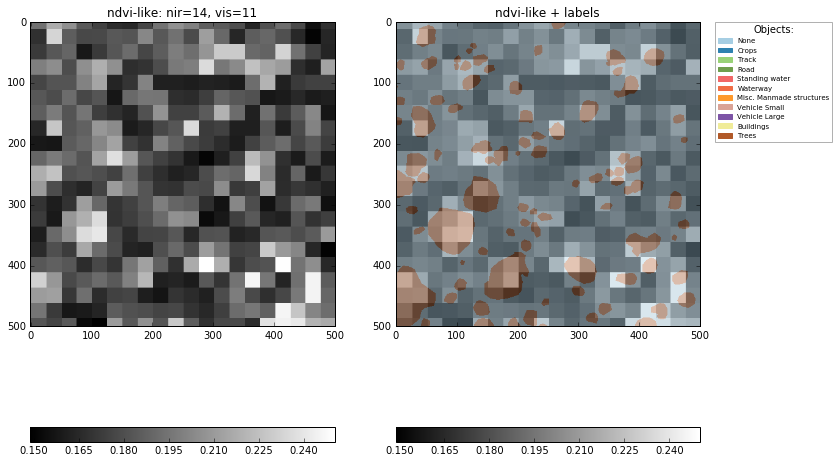

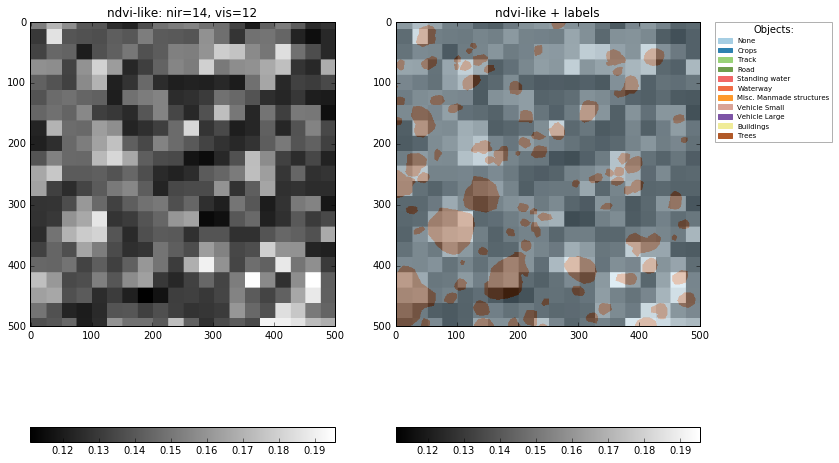

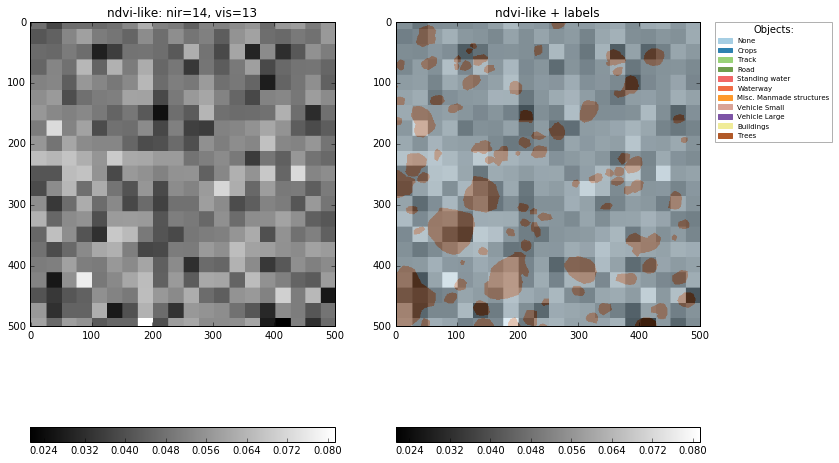

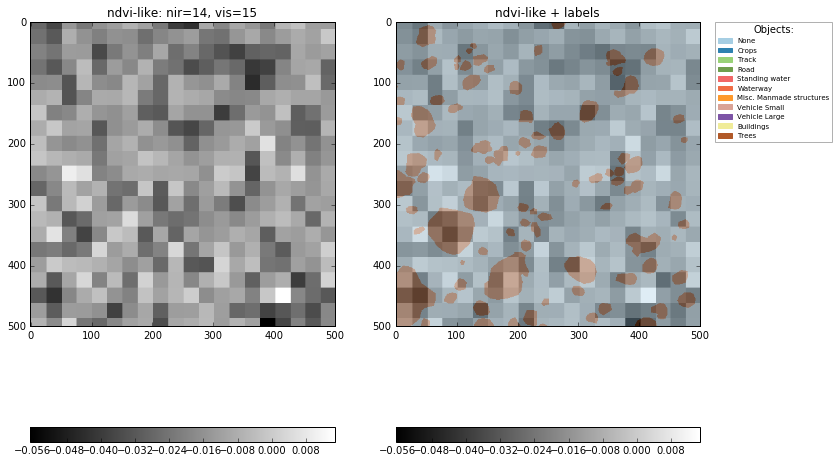

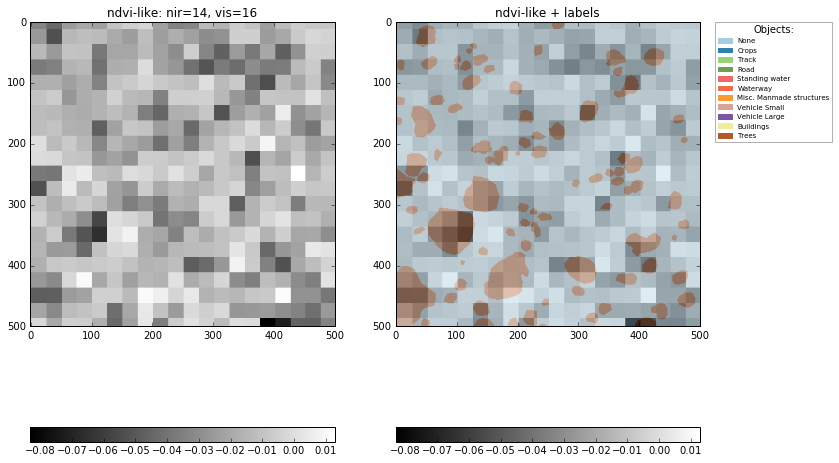

In [33]:
i = 14
for j in range(9,17):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

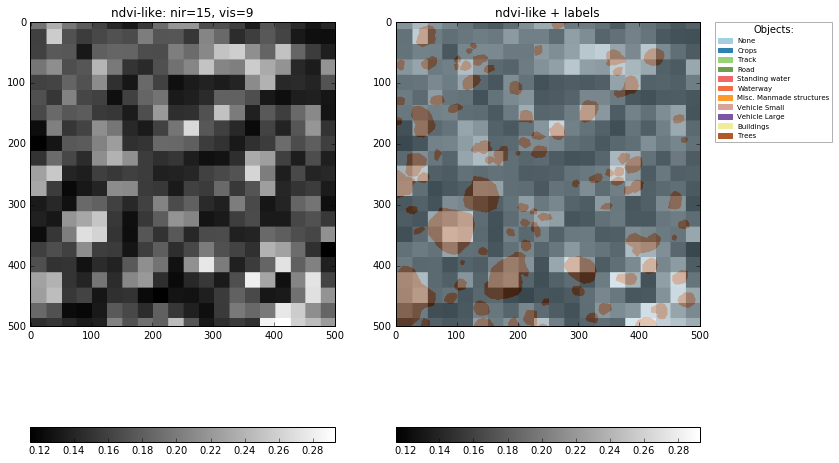

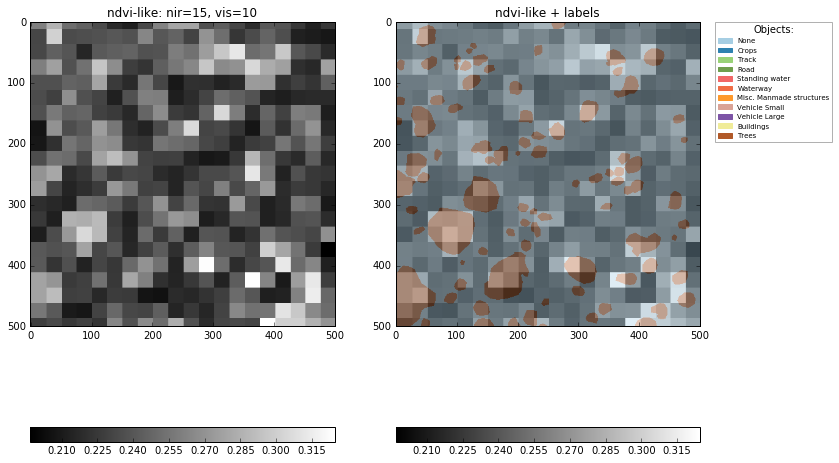

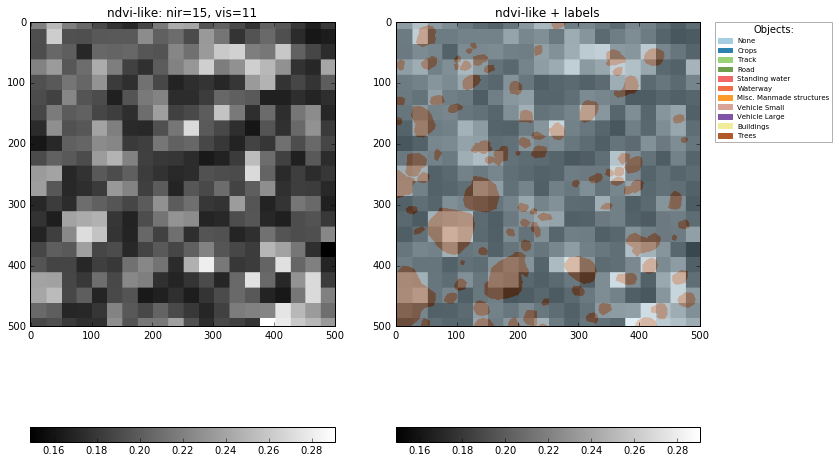

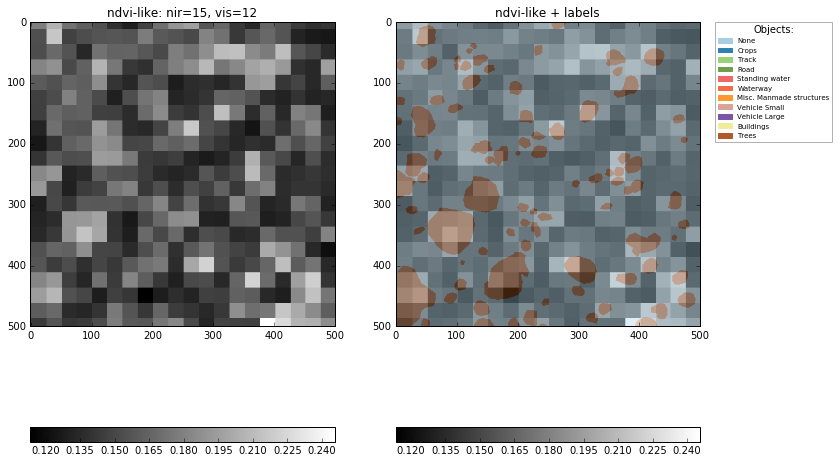

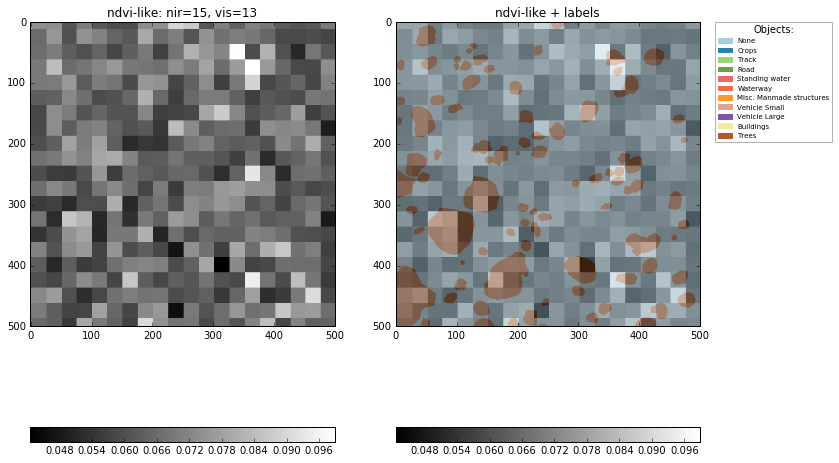

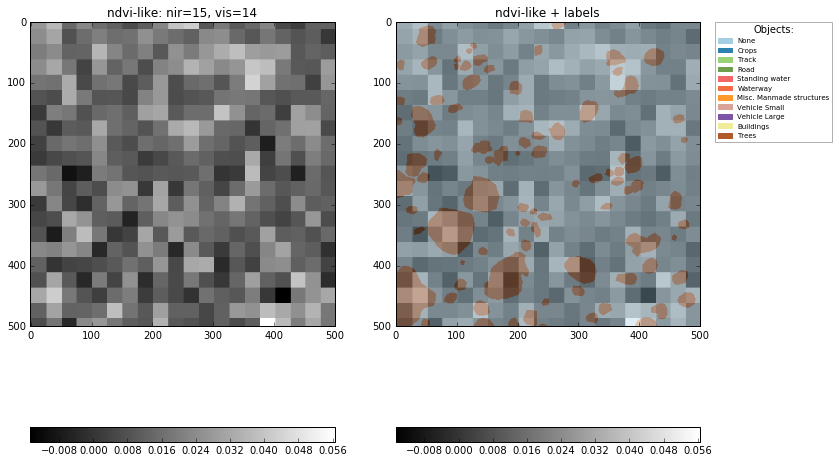

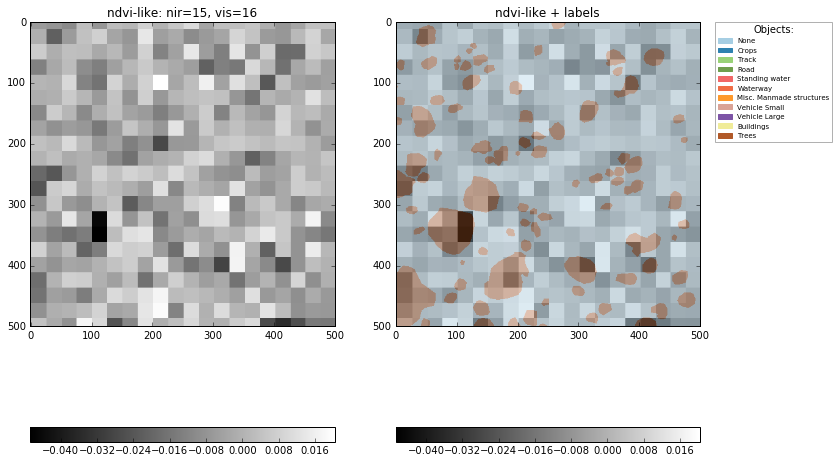

In [34]:
i = 15
for j in range(9,17):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

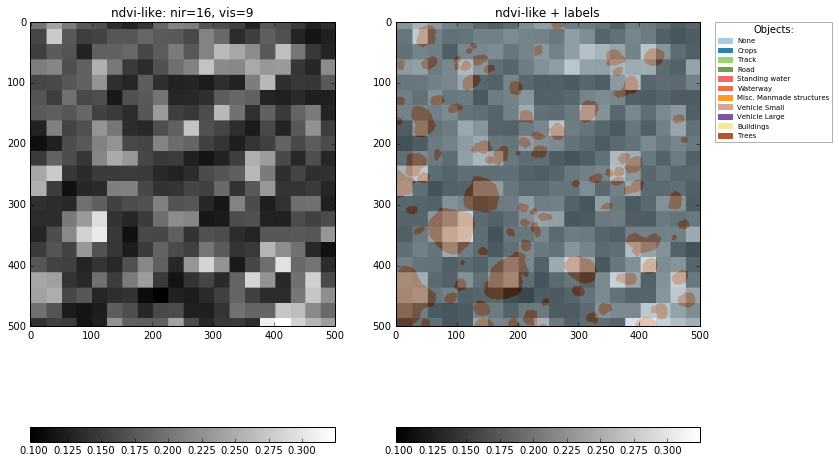

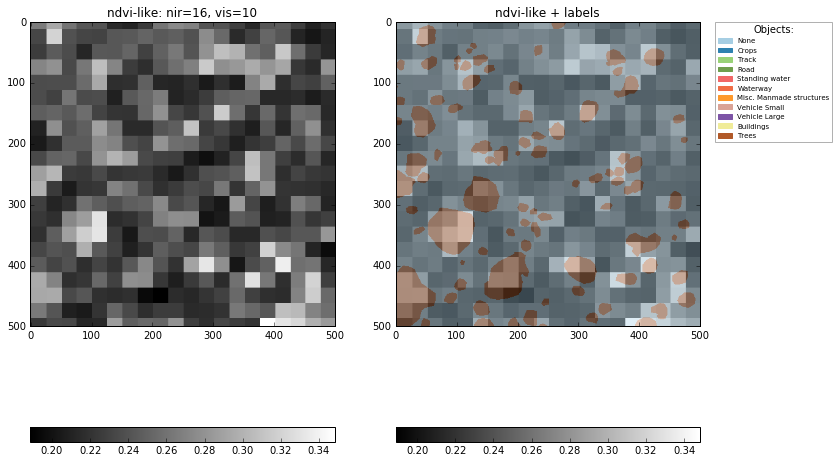

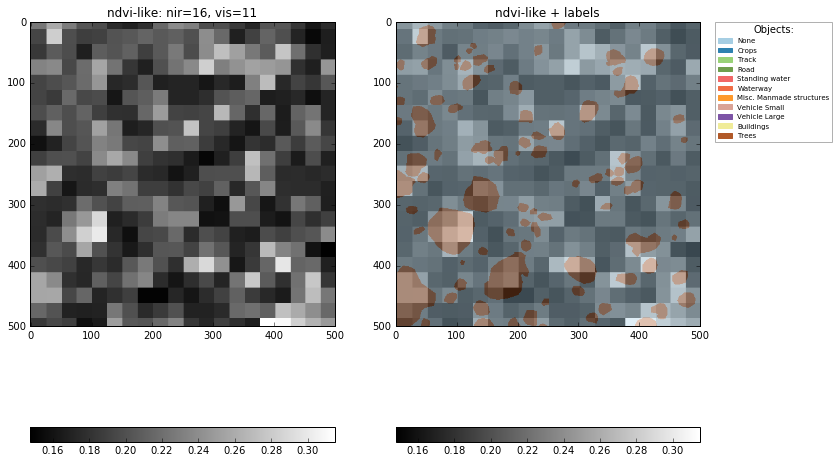

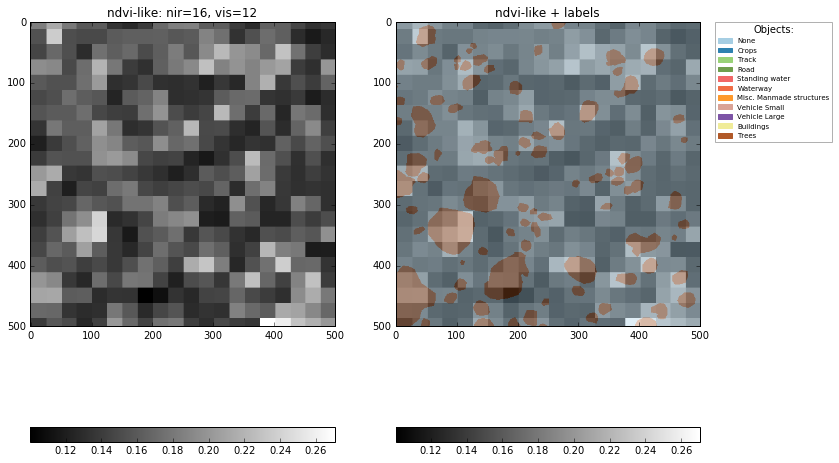

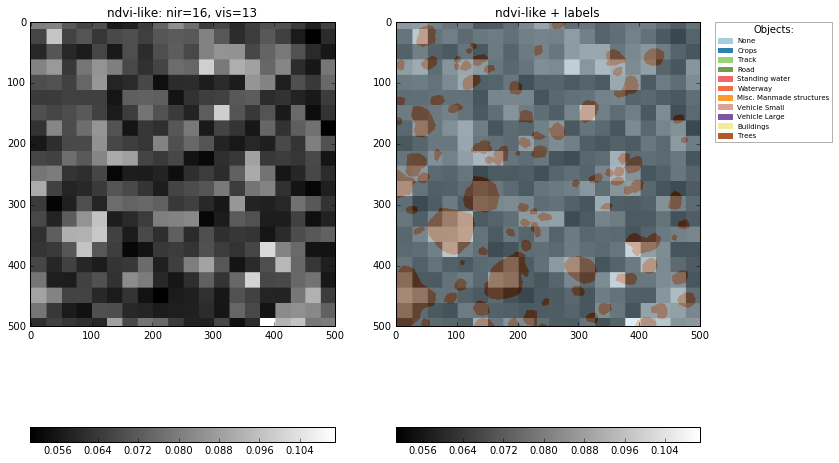

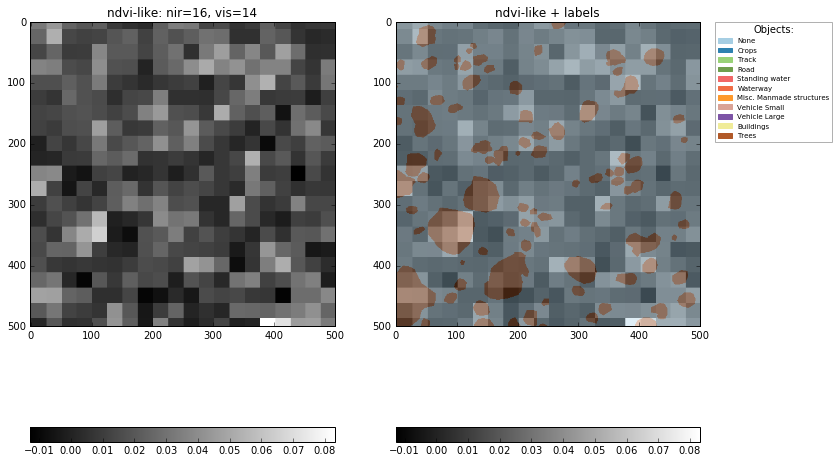

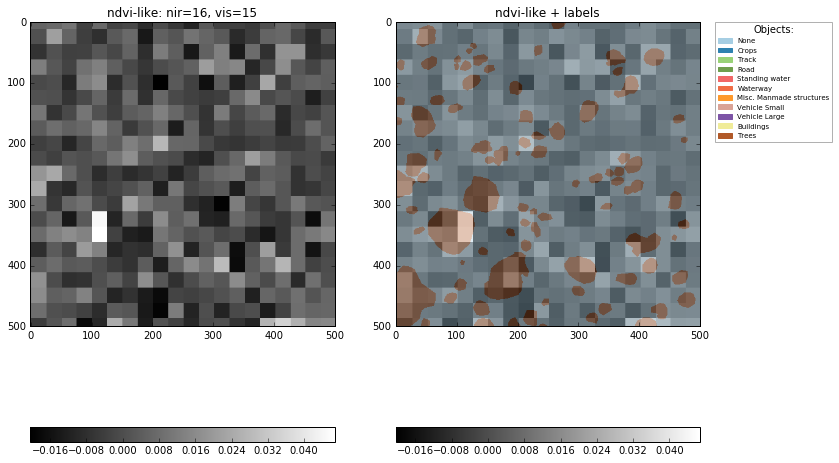

In [35]:
i = 16
for j in range(9,17):
    if i == j:
        continue
    ndvi_like = compute_ndvi_like(x, i, j)
    display_ndvi_like(ndvi_like, label_img, roi, 0.35, i, j)    

Visualize channels ratio

In [ ]:
i = 0
for j in range(17):
    if i >= j:
        continue
    display_ratio(x, i, j)    

In [ ]:
i = 1
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

In [ ]:
i = 2
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

In [ ]:
i = 3
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

In [ ]:
i = 4
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

In [ ]:
i = 5
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

In [ ]:
i = 6
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

In [ ]:
i = 7
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

In [ ]:
i = 8
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

In [ ]:
i = 9
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

In [ ]:
i = 10
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

In [ ]:
i = 11
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

In [ ]:
i = 12
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

In [ ]:
i = 13
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

In [ ]:
i = 14
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

In [ ]:
i = 15
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

In [ ]:
i = 16
for j in range(17):
    if i == j:
        continue
    display_ratio(x, i, j)

Some functions on channels

In [65]:
def compute_log(x, index):
    ch = x[:,:,index].astype(np.float32)
    ch = np.log(1 + ch)
    return ch

def compute_power(x, index, p):
    ch = x[:,:,index].astype(np.float32)
    ch = np.power(ch, p)
    return ch

In [69]:
def display_func(img, label_img, roi, alpha, title):
    fig_size = (12, 12)
    plt.figure(figsize=fig_size)
    plt.subplot(121)
    display_img_1b(img, roi)
    plt.title(title)
    plt.subplot(122)
    display_img_1b(img, roi)
    plt.title(title + " + labels")
    display_labels(label_img, roi, alpha=alpha, show_legend=True)

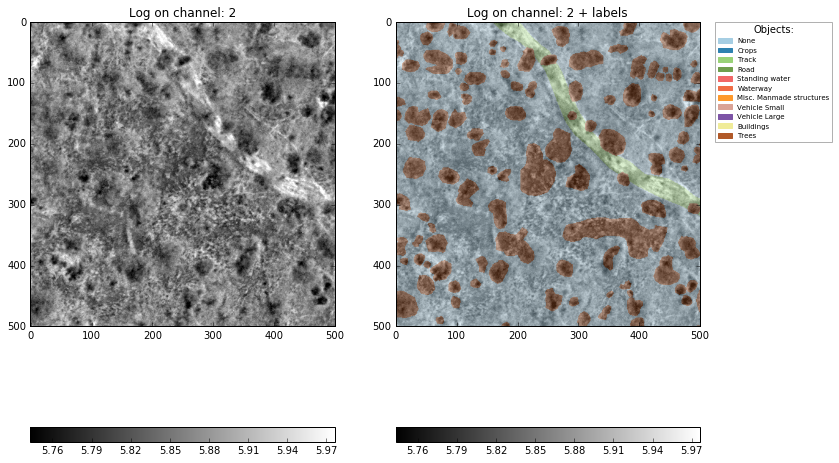

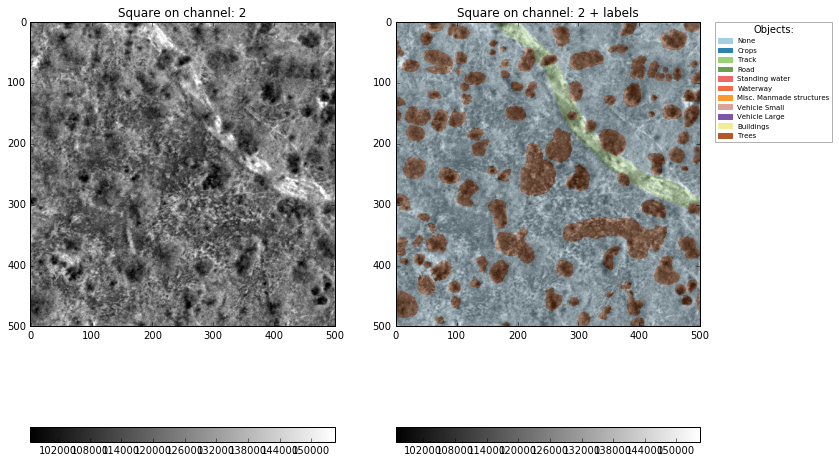

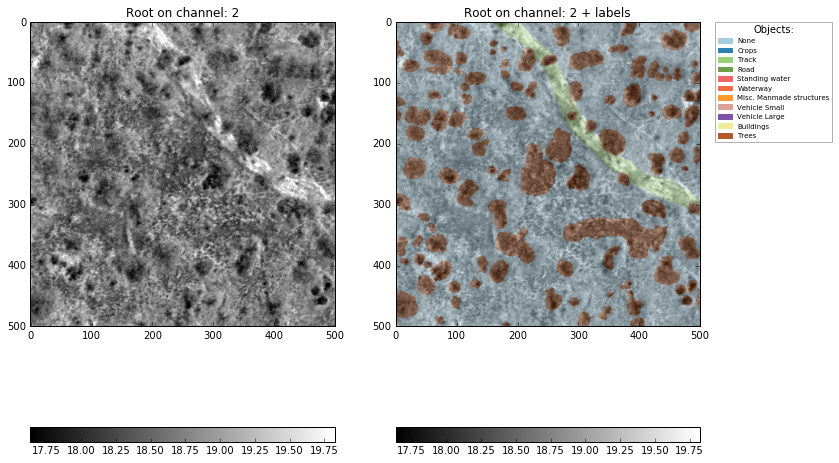

In [70]:
from ipywidgets import interact, IntSlider, FloatSlider

def interactive_func(i, roi_x, roi_y, alpha):
    
    img = compute_log(x, i)
    roi = [roi_x, roi_y, roi_x+500, roi_y+500]
    display_func(img, label_img, roi, alpha, "Log on channel: %i" % i)

    img = compute_power(x, i, 2.0)
    roi = [roi_x, roi_y, roi_x+500, roi_y+500]
    display_func(img, label_img, roi, alpha, "Square on channel: %i" % i)

    img = compute_power(x, i, 0.5)
    roi = [roi_x, roi_y, roi_x+500, roi_y+500]
    display_func(img, label_img, roi, alpha, "Root on channel: %i" % i)

    
_ = interact(interactive_func,           
     i=IntSlider(value=1, min=1, max=16, continuous_update=False), 
     roi_x=IntSlider(value=500, min=0, max=3500, continuous_update=False), 
     roi_y=IntSlider(value=1, min=0, max=3500, continuous_update=False), 
     alpha=FloatSlider(value=0.35, min=0, max=1.0, step=0.1, continuous_update=False))